# Yolo V3 Object Detection
Notebook is copied from face_extraction.ipynb.

Useful [resource](https://medium.com/@amrokamal_47691/yolo-yolov2-and-yolov3-all-you-want-to-know-7e3e92dc4899) on YOLO

In [1]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)



Mounted at /content/drive


In [2]:
!ls drive/'My Drive'/cs231n-project/datasets/emotiw/train | head


10_10.mp4
101_10.mp4
101_11.mp4
101_12.mp4
101_13.mp4
101_14.mp4
101_15.mp4
101_16.mp4
101_17.mp4
101_18.mp4


In [3]:
!pip3 install dlib
!pip3 install face_recognition

In [4]:
import glob
import json
import math
import os
import pickle 
import sys

import pprint

# enter the foldername in your Drive where you have saved the project contents
TRAINFOLDERNAME = 'datasets/emotiw/train'
MODELFOLDERNAME = 'datasets/emotiw/models'
assert TRAINFOLDERNAME is not None, "[!] Enter the foldername."
assert MODELFOLDERNAME is not None, "[!] Enter the foldername."

PROJECT_PATH = os.path.join('/content', 'drive', 'My Drive', 'cs231n-project')
TRAIN_PATH = os.path.join(PROJECT_PATH, TRAINFOLDERNAME)
MODEL_PATH = os.path.join(PROJECT_PATH, MODELFOLDERNAME)

sys.path.append(TRAIN_PATH)

from concurrent.futures import ThreadPoolExecutor
import cv2
import face_recognition
from google.colab.patches import cv2_imshow
from keras.models import load_model
from keras.preprocessing.image import load_img
from keras.preprocessing.image import img_to_array
import numpy as np

from yolov3 import yolo3_one_file_to_detect_them_all as yolo3_functions

# Note: No trailing slash
DOWNSAMPLE_RATIO = 1
SAMPLE_EVERY = 10 # eg. if using 30 FPS and SAMPLE_EVERY=10, we would produce at 3 FPS


Using TensorFlow backend.


In [0]:
def create_yolov3_model():
    """
    Create YOLO V3 Model using Pretrained weights

    Mostly following this tutorial: https://machinelearningmastery.com/how-to-perform-object-detection-with-yolov3-in-keras/
    """
    print('Defining the YOLO v3 Model')
    model = yolo3_functions.make_yolov3_model()

    print('Loading the model weights')
    weight_file = os.path.join(TRAIN_PATH, 'yolov3', 'yolov3.weights')
    weight_reader = yolo3_functions.WeightReader(weight_file)

    # Next, call the load_weights() function of the WeightReader instance
    # passing in our defined Keras model to set the weights into the layers.
    print('Setting the model weights')
    weight_reader.load_weights(model)

    # Next, save this model to a Keras compatible .h5 model file ready for later use.
    print('Saving the model')
    model.save(os.path.join(MODEL_PATH, 'yolov3_model.h5'))


In [0]:
def process_video(video_dir, video_name, video_num, total_videos, model):
    """
    Processes a video by extracting the faces from each frame and creating a 
    list of list of faces which is then saved as a pickled object.

    NOTE: Faces are not guaranteed to be the same across frames.
          eg. 'face 1' in frame 1 may not be the same as 'face 1' in frame 2

    Pickle Object Format:
        [
            [
                [frame 1, face 1],
                [frame 1, face 2],
                [frame 1, face 3]
            ],
            [
                [frame 2, face 1],
                [frame 2, face 2]
            ],
            ...
        ]

    """
    print(f"Processing video {video_num}/{total_videos} with name {video_name}\n")
    vidcap = cv2.VideoCapture(os.path.join(video_dir, video_name))

    input_length = int(vidcap.get(cv2.CAP_PROP_FRAME_COUNT))
    frame_width = int(vidcap.get(cv2.CAP_PROP_FRAME_WIDTH))
    frame_height = int(vidcap.get(cv2.CAP_PROP_FRAME_HEIGHT))
    fps = int(vidcap.get(cv2.CAP_PROP_FPS))

    metadata = {}
    metadata[video_name] = {}
    faces_all_frames = []
    success, orig_image = vidcap.read()
    count = 0
    i = 1
    while success:
        if count % SAMPLE_EVERY == 0:
            print(f"   Working on {video_name} frame {count} video num {video_num}")
            # NOTE:
            # cv2_imshow is used by Colab in place of cv2.imshow('image', image) as 
            # the latter command is known to crash Jupyter sessions in Colab

            if video_num == 0 and count == 0:
                print(f"Showing sample frame for {video_name} with shape {orig_image.shape}")
                print("=" * 20)

            image_h, image_w = orig_image.shape[:2]
            print('printing type image')
            print(type(orig_image))

            if video_num == 0 and count == 0:
                print("Original frame: ")
                cv2_imshow(orig_image)
                print("")

            # Convert from BGR color (OpenCV) to RGB color (face_recognition)
            # rgb_image = image[:, :, ::-1]

            # https://machinelearningmastery.com/how-to-perform-object-detection-with-yolov3-in-keras/
            # The first step is to load the Keras model. This might be the slowest part of making a prediction.
            # Resize the image because YOLO expects 416 by 416
            # define the expected input shape for the model
            input_w, input_h = 416, 416
            image = cv2.resize(orig_image, (input_w, input_h), interpolation = cv2.INTER_CUBIC)
            print('Shape of image is {}'.format(image.shape))

            # scale pixel values to [0, 1]
            image = image.astype('float32')
            image /= 255.0

            # add a dimension so that we have one sample
            image = np.expand_dims(image, 0)

            # We can now feed the photo into the Keras model and make a prediction.
            # Make Prediction
            yhat = model.predict(image)

            print('Summarize the shape of the list of arrays')
            print([a.shape for a in yhat])

            # define the anchors
            anchors = [[116,90, 156,198, 373,326], [30,61, 62,45, 59,119], [10,13, 16,30, 33,23]]
            
            # define the probability threshold for detected objects
            class_threshold = 0.6
            boxes = list()
            for i in range(len(yhat)):
                # decode the output of the network
                boxes += yolo3_functions.decode_netout(yhat[i][0], anchors[i], class_threshold, input_h, input_w)
            
            # correct the sizes of the bounding boxes for the shape of the image
            yolo3_functions.correct_yolo_boxes(boxes, image_h=image_h, image_w=image_w, net_h=input_h, net_w=input_w)
            
            # suppress non-maximal boxes
            yolo3_functions.do_nms(boxes, 0.5)
            
            # define the labels
            # Double check all the categories that YoloV3 can predict 
            labels = ["person", "bicycle", "car", "motorbike", "aeroplane", "bus", "train", "truck",
              "boat", "traffic light", "fire hydrant", "stop sign", "parking meter", "bench",
              "bird", "cat", "dog", "horse", "sheep", "cow", "elephant", "bear", "zebra", "giraffe",
              "backpack", "umbrella", "handbag", "tie", "suitcase", "frisbee", "skis", "snowboard",
              "sports ball", "kite", "baseball bat", "baseball glove", "skateboard", "surfboard",
              "tennis racket", "bottle", "wine glass", "cup", "fork", "knife", "spoon", "bowl", "banana",
              "apple", "sandwich", "orange", "broccoli", "carrot", "hot dog", "pizza", "donut", "cake",
              "chair", "sofa", "pottedplant", "bed", "diningtable", "toilet", "tvmonitor", "laptop", "mouse",
              "remote", "keyboard", "cell phone", "microwave", "oven", "toaster", "sink", "refrigerator",
              "book", "clock", "vase", "scissors", "teddy bear", "hair drier", "toothbrush"]
           
            # get the details of the detected objects
            v_boxes, v_labels, v_scores = yolo3_functions.get_boxes(boxes, labels, class_threshold)
            
            # summarize what we found
            for i in range(len(v_boxes)):
                print(v_labels[i], v_scores[i])
            
            # draw what we found
            yolo3_functions.draw_boxes(orig_image, v_boxes, v_labels, v_scores)

            v_box_locations = [(v_box.xmin, v_box.xmax, v_box.ymin, v_box.ymax) for v_box in v_boxes]

            metadata[video_name][count] = {
                'vboxes': v_box_locations,
                'v_labels': v_labels,
                'v_scores': v_scores,
            }

        success, orig_image = vidcap.read()
        count += 1
    video_num += 1
    vidcap.release()

    return metadata


In [7]:
create_yolov3_model()

Defining the YOLO v3 Model
Loading the model weights
Setting the model weights
loading weights of convolution #0
loading weights of convolution #1
loading weights of convolution #2
loading weights of convolution #3
no convolution #4
loading weights of convolution #5
loading weights of convolution #6
loading weights of convolution #7
no convolution #8
loading weights of convolution #9
loading weights of convolution #10
no convolution #11
loading weights of convolution #12
loading weights of convolution #13
loading weights of convolution #14
no convolution #15
loading weights of convolution #16
loading weights of convolution #17
no convolution #18
loading weights of convolution #19
loading weights of convolution #20
no convolution #21
loading weights of convolution #22
loading weights of convolution #23
no convolution #24
loading weights of convolution #25
loading weights of convolution #26
no convolution #27
loading weights of convolution #28
loading weights of convolution #29
no convol

In [8]:
# Testing for one video
# Note you might get an error that says UserWarning: No training configuration found in save file
# Seems like it's ok to ignore for now: https://github.com/fizyr/keras-retinanet/issues/207
print('Loading YOLO v3 Keras Model')
model = load_model(os.path.join(MODEL_PATH, 'yolov3_model.h5'))
metadata = process_video(video_dir=TRAIN_PATH, video_name="2_1.mp4", video_num=0, total_videos=10, model=model)

Output hidden; open in https://colab.research.google.com to view.

In [9]:
pprint.pprint(metadata)

{'2_1.mp4': {0: {'v_labels': ['person',
                              'person',
                              'person',
                              'person',
                              'person',
                              'tvmonitor',
                              'person',
                              'person'],
                 'v_scores': [92.55717992782593,
                              99.32825565338135,
                              96.99269533157349,
                              96.49882912635803,
                              99.48840141296387,
                              82.02412128448486,
                              72.56042957305908,
                              80.83866834640503],
                 'vboxes': [(0, 123, 46, 334),
                            (191, 383, 18, 379),
                            (333, 458, 30, 374),
                            (388, 492, 20, 402),
                            (102, 229, 84, 352),
                            (56, 441, 11

['344_7.mp4', '260_13.mp4', '220_4.mp4', '245_8.mp4', '229_1.mp4', '271_4.mp4', '253_1.mp4', '225_2.mp4', '215_5.mp4', '229_3.mp4', '245_14.mp4', '216_11.mp4', '221_9.mp4', '260_3.mp4', '245_1.mp4', '210_20.mp4', '245_3.mp4', '245_10.mp4', '270_1.mp4', '256_3.mp4', '244_4.mp4', '271_8.mp4', '223_16.mp4', '223_12.mp4', '246_1.mp4', '266_3.mp4', '260_2.mp4', '253_5.mp4', '228_7.mp4', '221_10.mp4', '228_3.mp4', '245_5.mp4', '217_14.mp4', '225_1.mp4', '262_4.mp4', '210_12.mp4', '258_5.mp4', '263_4.mp4', '241_4.mp4', '234_3.mp4', '235_1.mp4', '223_2.mp4', '269_3.mp4', '253_6.mp4', '217_15.mp4', '248_2.mp4', '260_9.mp4', '234_5.mp4', '265_1.mp4', '260_8.mp4', '240_1.mp4', '229_4.mp4', '228_6.mp4', '217_5.mp4', '220_1.mp4', '262_6.mp4', '210_22.mp4', '241_2.mp4', '230_6.mp4', '245_12.mp4', '260_11.mp4', '246_7.mp4', '267_8.mp4', '256_8.mp4', '223_7.mp4', '216_4.mp4', '258_2.mp4', '210_19.mp4', '216_9.mp4', '228_2.mp4', '240_3.mp4', '262_1.mp4', '230_2.mp4', '214_3.mp4', '221_8.mp4', '221_3.mp

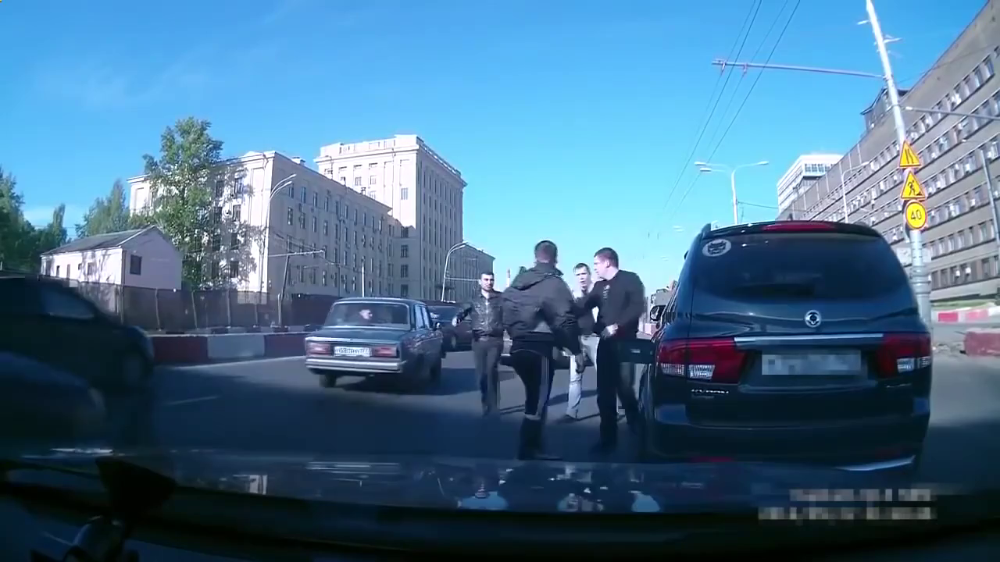


Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 97.57198691368103
person 99.51704144477844
person 98.67278337478638
car 96.39163613319397


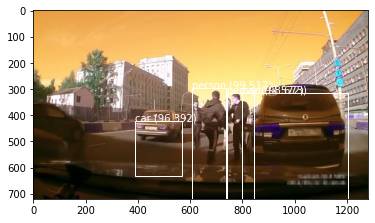

   Working on 344_7.mp4 frame 10 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 97.38446474075317
car 89.76134657859802
person 99.24635291099548
person 99.0748405456543
person 84.48657989501953


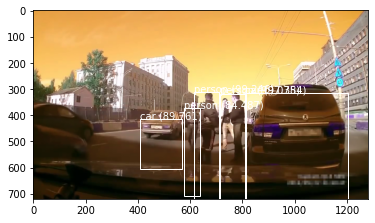

   Working on 344_7.mp4 frame 20 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 96.34990692138672
car 95.99777460098267
person 87.6770555973053
person 99.57035779953003
person 99.22847747802734


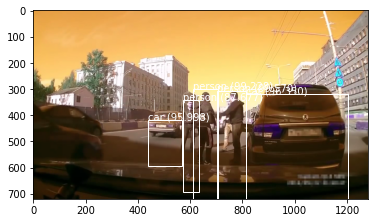

   Working on 344_7.mp4 frame 30 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 97.40475416183472
car 97.40945100784302
person 99.48092103004456
person 81.91375732421875
person 98.40772151947021
car 73.15496802330017


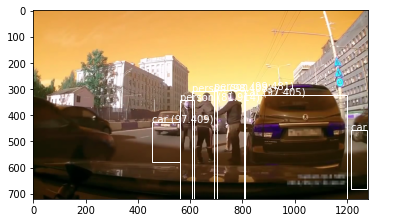

   Working on 344_7.mp4 frame 40 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 97.85013198852539
car 92.14606285095215
person 87.45733499526978
person 97.59610295295715
car 83.88689160346985
person 87.9371702671051


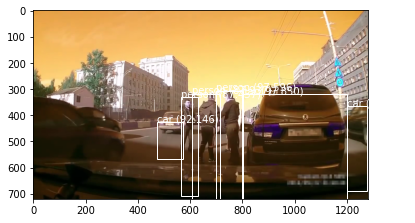

   Working on 344_7.mp4 frame 50 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 96.49754166603088
car 89.62339162826538
car 90.99457859992981
person 70.71163654327393
person 90.20935893058777
person 99.56693649291992


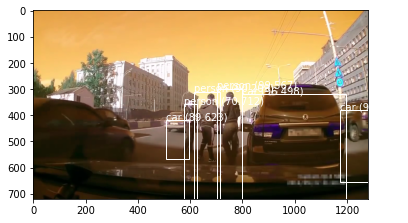

   Working on 344_7.mp4 frame 60 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 97.2830593585968
car 87.55252957344055
car 71.30575180053711
person 84.84773635864258
person 98.18800687789917


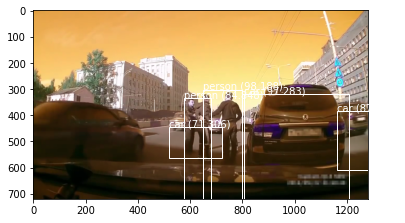

   Working on 344_7.mp4 frame 70 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 95.67422866821289
person 98.65154027938843
person 99.82508420944214


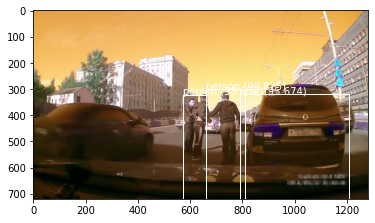

   Working on 344_7.mp4 frame 80 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 97.18588590621948
person 97.75699377059937
person 99.84964728355408


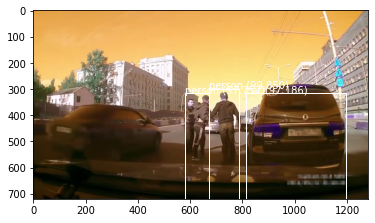

   Working on 344_7.mp4 frame 90 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 96.13384008407593
person 94.4361925125122
person 88.89224529266357
person 98.99446964263916


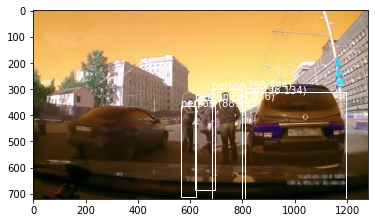

   Working on 344_7.mp4 frame 100 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 97.61334657669067
car 95.89189887046814
person 84.95317697525024
person 98.0730414390564
person 83.02340507507324


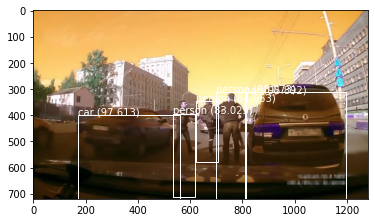

   Working on 344_7.mp4 frame 110 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.8006820678711
car 96.55805230140686
person 97.99201488494873
person 99.29019808769226
person 77.98492312431335


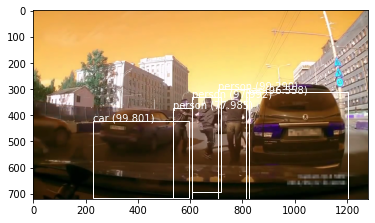

   Working on 344_7.mp4 frame 120 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.69432950019836
car 94.96017098426819
car 65.5116856098175
person 96.91022634506226
person 98.0425477027893


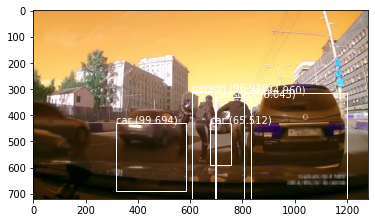

   Working on 344_7.mp4 frame 130 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 94.56634521484375
car 97.98678755760193
person 96.57797813415527
person 99.59633350372314


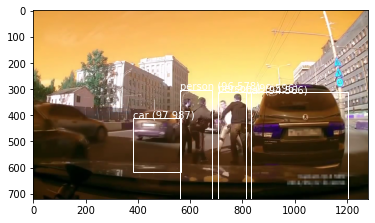

   Working on 344_7.mp4 frame 140 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 96.27894163131714
car 98.45172762870789
person 99.03712868690491
person 75.08675456047058
person 99.68857169151306


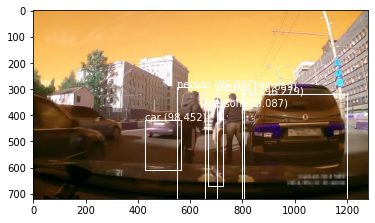

Processing video 0/10 with name 260_13.mp4

   Working on 260_13.mp4 frame 0 video num 0
Showing sample frame for 260_13.mp4 with shape (720, 1280, 3)
printing type image
<class 'numpy.ndarray'>
Original frame: 


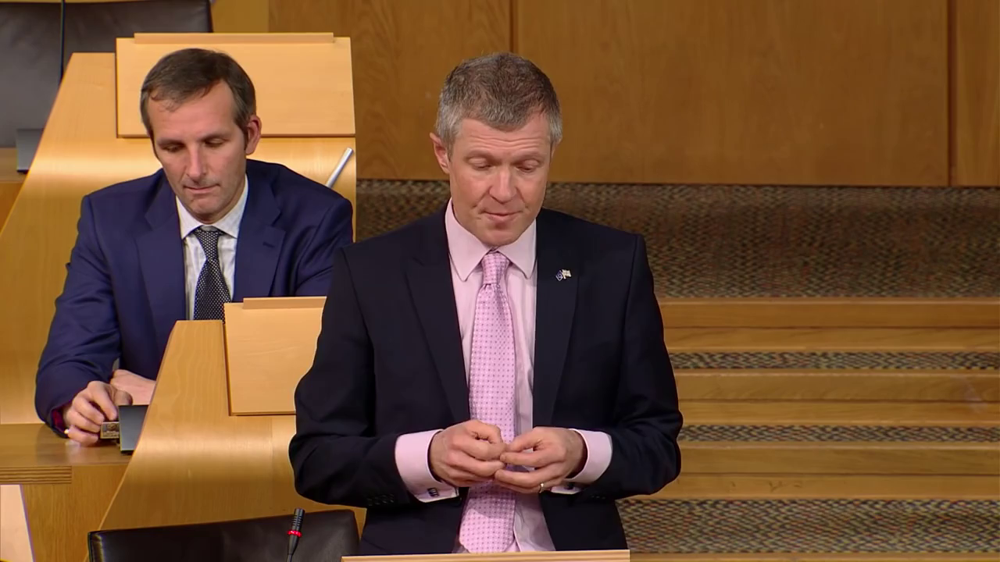


Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 98.3810544013977
person 99.41550493240356
tie 98.0538547039032
tie 62.95821666717529


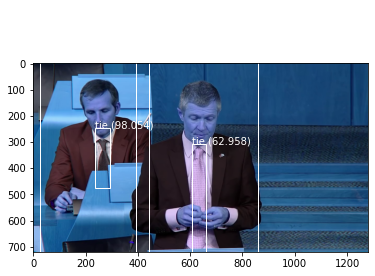

   Working on 260_13.mp4 frame 10 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 98.44929575920105
person 99.25366044044495
tie 98.22301268577576
tie 72.52227067947388


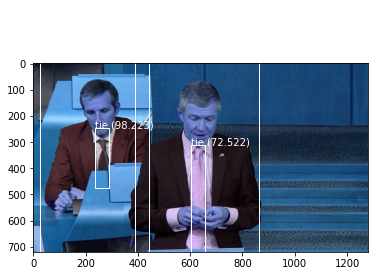

   Working on 260_13.mp4 frame 20 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 98.74993562698364
person 99.61992502212524
tie 97.6663589477539
tie 65.4788613319397


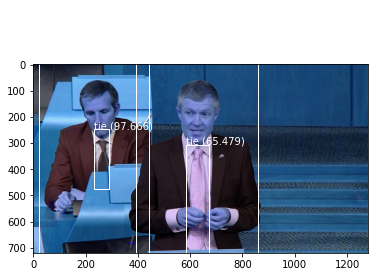

   Working on 260_13.mp4 frame 30 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 98.43495488166809
person 99.49256181716919
tie 97.1218466758728
tie 61.22894883155823


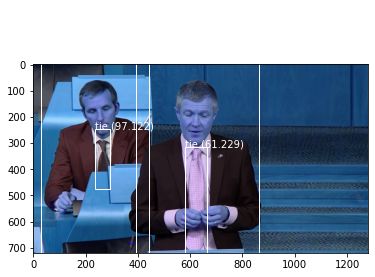

   Working on 260_13.mp4 frame 40 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 98.30766320228577
person 99.34112429618835
tie 96.58006429672241


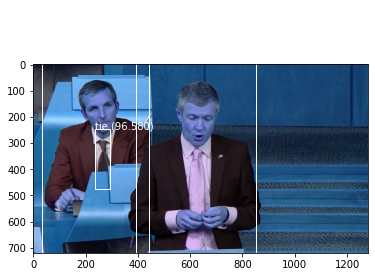

   Working on 260_13.mp4 frame 50 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 97.86590933799744
person 99.09775257110596
tie 97.15009331703186


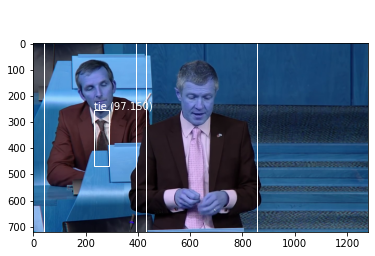

   Working on 260_13.mp4 frame 60 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 98.26735258102417
person 99.57767128944397
tie 97.1303403377533


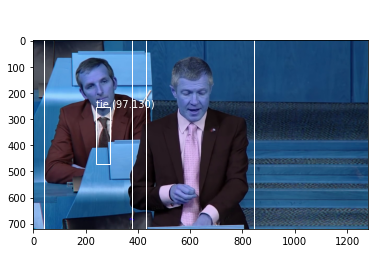

   Working on 260_13.mp4 frame 70 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 97.04675078392029
person 99.59680438041687
tie 98.43640327453613


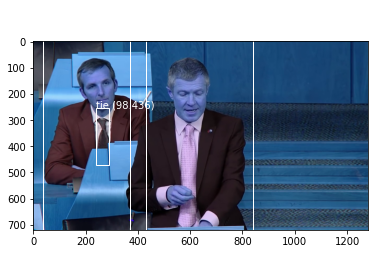

   Working on 260_13.mp4 frame 80 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 96.82567715644836
person 99.54665899276733
tie 97.94778823852539
tie 67.3659086227417


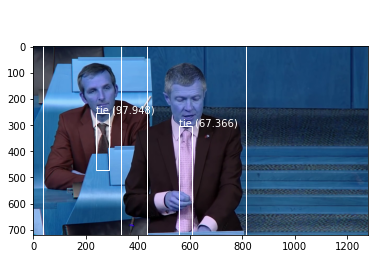

   Working on 260_13.mp4 frame 90 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 98.09294939041138
person 99.71480965614319
tie 97.78275489807129


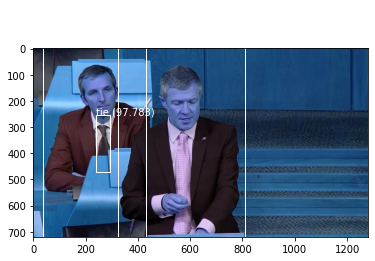

   Working on 260_13.mp4 frame 100 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 97.60504961013794
person 99.64280128479004
tie 97.1733808517456


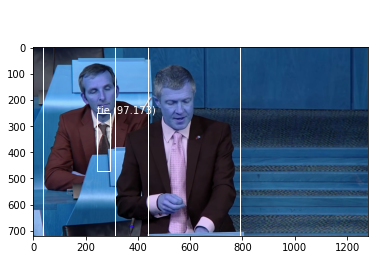

   Working on 260_13.mp4 frame 110 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 97.4360466003418
person 99.76494908332825
tie 97.2299337387085
tie 60.76897978782654


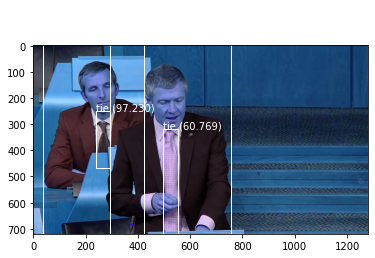

   Working on 260_13.mp4 frame 120 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 96.49948477745056
person 99.79613423347473
tie 97.73234128952026


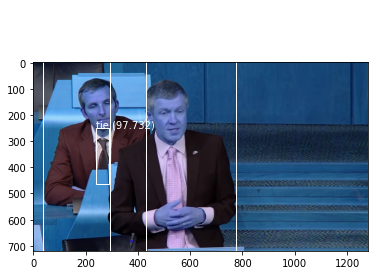

Processing video 0/10 with name 220_4.mp4

   Working on 220_4.mp4 frame 0 video num 0
Showing sample frame for 220_4.mp4 with shape (720, 1280, 3)
printing type image
<class 'numpy.ndarray'>
Original frame: 


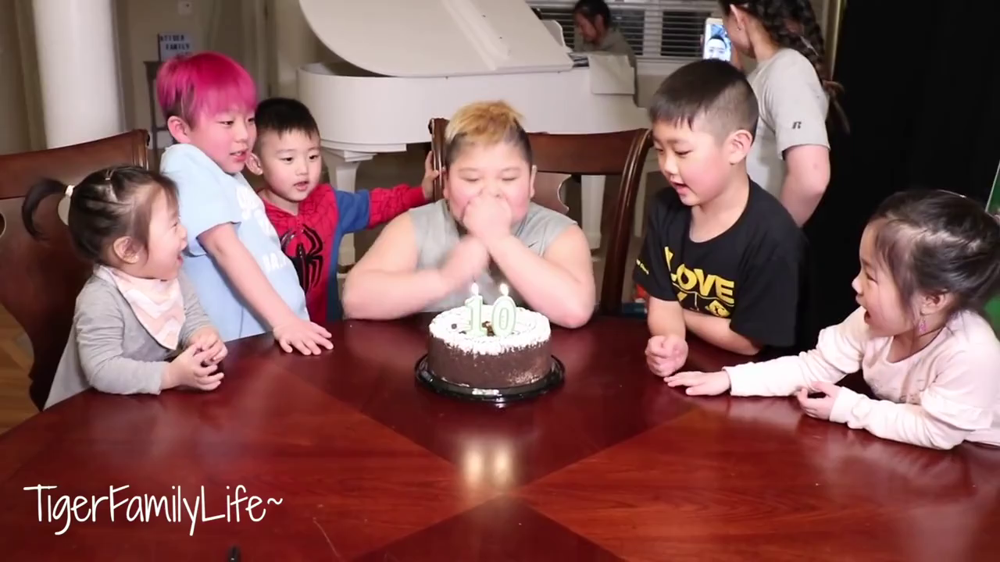


Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 93.37350130081177
person 98.75473976135254
person 97.98406958580017
person 85.79468131065369
person 97.66712784767151
diningtable 99.83903169631958
cake 98.68233799934387


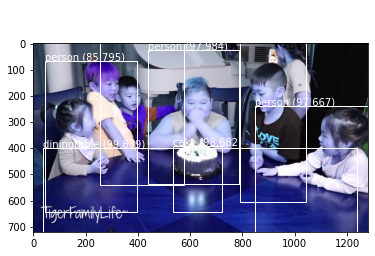

   Working on 220_4.mp4 frame 10 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 98.69308471679688
person 96.34346961975098
person 94.80247497558594
person 94.59137916564941
person 97.05986380577087
diningtable 99.5656967163086
cake 99.62592720985413


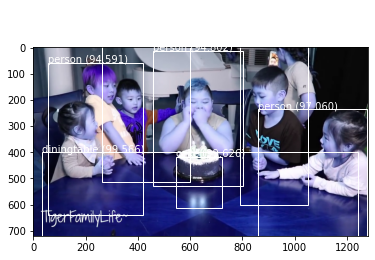

   Working on 220_4.mp4 frame 20 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.28143620491028
person 95.21427750587463
person 95.97516059875488
person 91.24647974967957
person 83.80441665649414
diningtable 99.69719648361206
cake 97.6979672908783


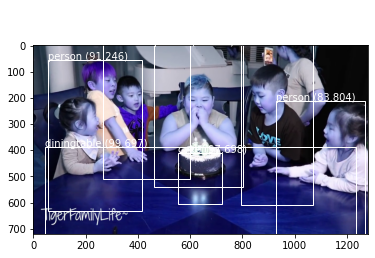

   Working on 220_4.mp4 frame 30 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 96.07131481170654
person 96.12021446228027
person 98.30538034439087
person 97.08840250968933
person 95.44102549552917
person 89.95137810707092
diningtable 99.85589981079102
cake 98.84951114654541


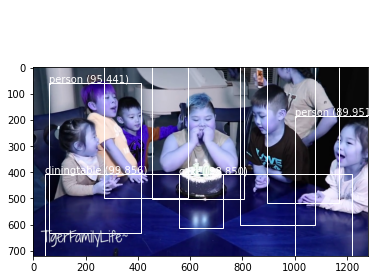

   Working on 220_4.mp4 frame 40 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 94.68203783035278
person 99.25154447555542
person 94.89178657531738
person 97.9982316493988
person 95.43428421020508
person 90.87280035018921
diningtable 99.93948936462402
person 73.70699048042297
cake 98.44130873680115


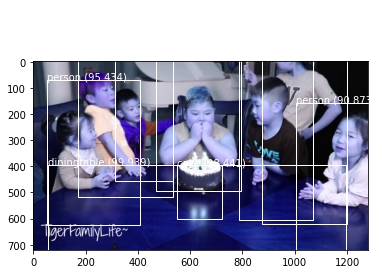

   Working on 220_4.mp4 frame 50 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 97.18006253242493
person 94.650799036026
person 93.42244863510132
person 98.78080487251282
person 98.14007878303528
person 89.87506031990051
person 95.936119556427
diningtable 99.42981004714966
cake 99.07306432723999


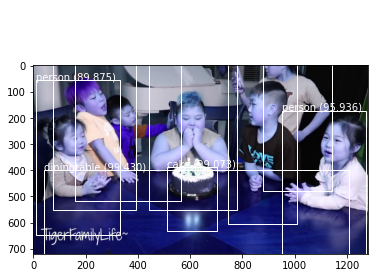

   Working on 220_4.mp4 frame 60 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 95.385080575943
person 94.55288648605347
person 89.57297801971436
person 98.09717535972595
person 98.93016815185547
person 96.59509658813477
person 85.18253564834595
diningtable 96.41371965408325
cake 99.05622601509094


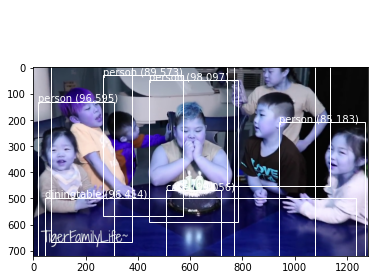

   Working on 220_4.mp4 frame 70 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 97.26647734642029
person 88.94267082214355
person 91.29549264907837
person 97.10125923156738
person 98.76459240913391
person 96.7714011669159
person 92.86473989486694
diningtable 96.22532725334167
cake 99.1986334323883


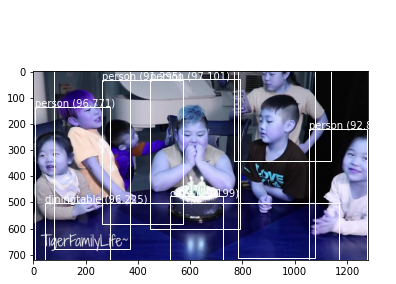

   Working on 220_4.mp4 frame 80 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 94.55993175506592
person 94.79794502258301
person 80.58291673660278
person 99.45594668388367
person 99.11036491394043
person 99.10884499549866
diningtable 97.32686877250671
cake 99.59748387336731
person 96.10766172409058


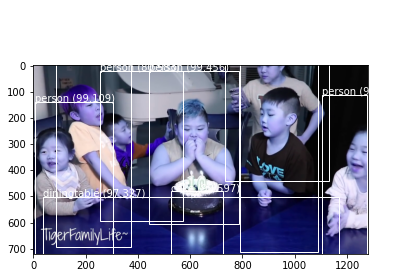

   Working on 220_4.mp4 frame 90 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 89.63568210601807
person 98.47556948661804
person 97.45875597000122
person 96.82223200798035
person 98.53320121765137
diningtable 97.18754291534424
cake 98.84792566299438


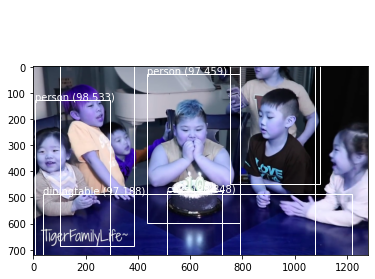

   Working on 220_4.mp4 frame 100 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 95.50349712371826
person 98.086678981781
person 98.54547381401062
person 97.01016545295715
person 90.31242728233337
diningtable 96.03160619735718
person 72.02356457710266
cake 99.31751489639282


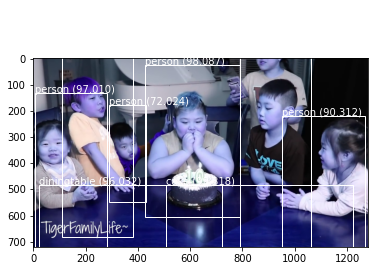

   Working on 220_4.mp4 frame 110 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 97.53543138504028
person 98.4850823879242
person 98.33259582519531
person 98.33285808563232
person 87.76958584785461
diningtable 96.3547945022583
person 85.21109223365784
cake 99.16123747825623


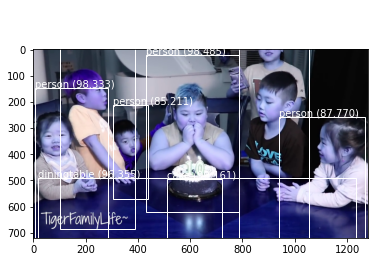

   Working on 220_4.mp4 frame 120 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 89.08817768096924
person 97.50770330429077
person 99.35083985328674
person 98.23863506317139
sofa 61.01543307304382
person 97.75679111480713
diningtable 93.89811754226685
person 89.15657997131348
cake 97.00923562049866


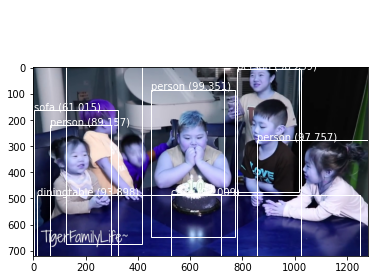

   Working on 220_4.mp4 frame 130 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 89.4390344619751
person 84.53984260559082
person 86.75861954689026
person 99.02960658073425
person 97.96761870384216
person 97.28626012802124
diningtable 97.01393246650696
person 62.65825033187866
person 65.67278504371643
cake 97.64930605888367


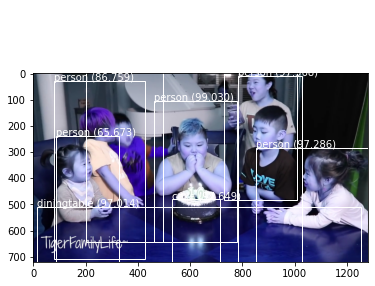

   Working on 220_4.mp4 frame 140 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 74.62649345397949
person 98.31134080886841
person 99.32156801223755
person 94.80584263801575
person 63.95747661590576
person 95.53444981575012
diningtable 93.44751834869385
person 84.84649062156677
cake 98.18689227104187


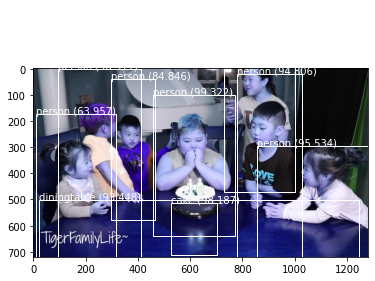

Processing video 0/10 with name 245_8.mp4

   Working on 245_8.mp4 frame 0 video num 0
Showing sample frame for 245_8.mp4 with shape (720, 1280, 3)
printing type image
<class 'numpy.ndarray'>
Original frame: 


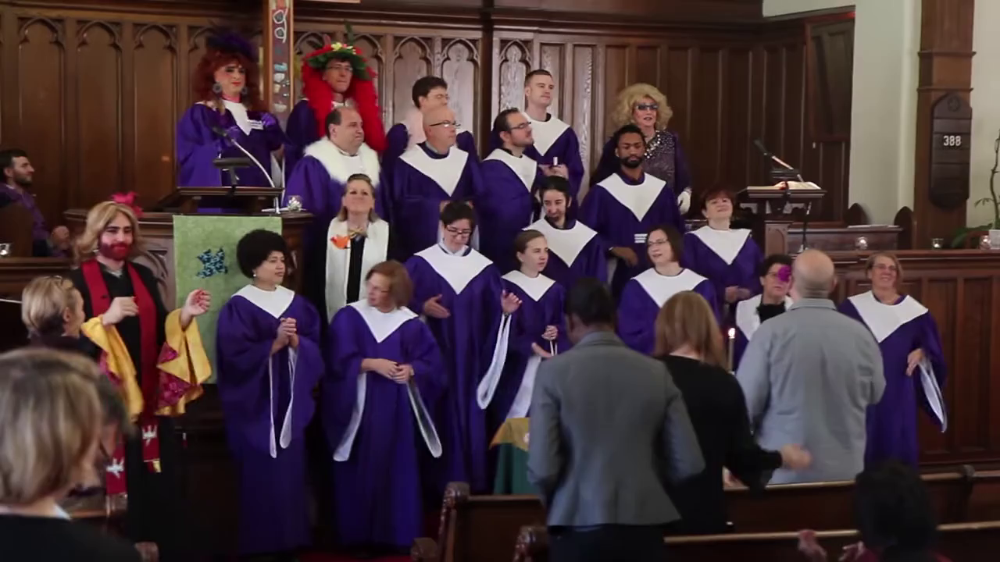


Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.78351593017578
person 68.61786842346191
person 68.21856498718262
person 63.43938112258911
person 62.829625606536865
person 80.85032105445862
person 82.33274817466736
person 60.32761335372925
person 69.59142088890076
person 99.86622929573059
person 86.34486198425293
person 93.06149482727051
person 97.96653389930725
person 89.95468020439148
person 93.80745887756348
suitcase 68.84243488311768


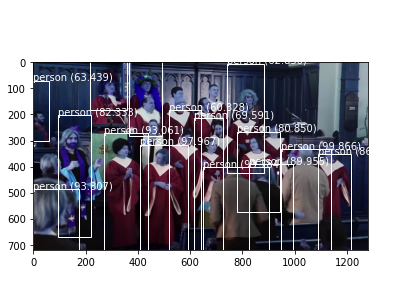

   Working on 245_8.mp4 frame 10 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.94711875915527
person 96.19797468185425
person 64.81208801269531
person 86.25876903533936
person 71.923166513443
person 73.73613715171814
person 70.36319375038147
person 75.83686709403992
person 66.14689230918884
person 77.58033275604248
person 77.96501517295837
person 92.98371076583862
person 99.93272423744202
person 89.91272449493408
person 97.22384214401245
person 61.81398034095764
person 88.75953555107117


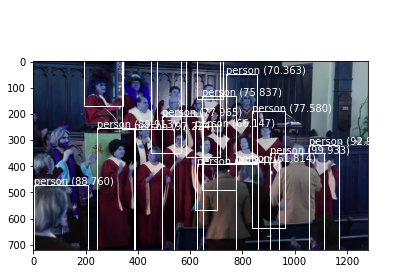

   Working on 245_8.mp4 frame 20 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.89137053489685
person 91.4729118347168
person 80.54202198982239
person 66.90957546234131
person 62.56265640258789
person 60.00124216079712
person 65.68729877471924
person 74.66300129890442
person 99.78423118591309
person 69.15435194969177
person 96.25857472419739


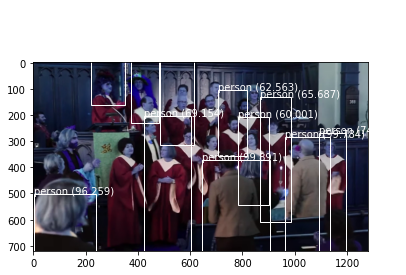

   Working on 245_8.mp4 frame 30 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.92873668670654
person 93.274587392807
person 70.71376442909241
person 63.40118646621704
person 71.14019989967346
person 76.82742476463318
person 61.03121638298035
person 61.789971590042114
person 92.09423065185547
person 89.52117562294006


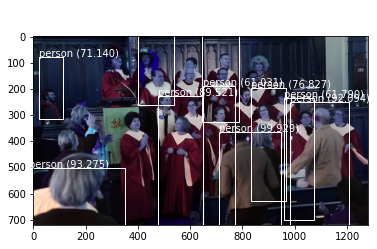

   Working on 245_8.mp4 frame 40 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.69579577445984
person 99.80841279029846
person 95.14897465705872
person 92.08888411521912
person 80.47855496406555
person 75.14281272888184
person 71.08439803123474
person 81.20010495185852
person 64.28133845329285
person 76.35895609855652


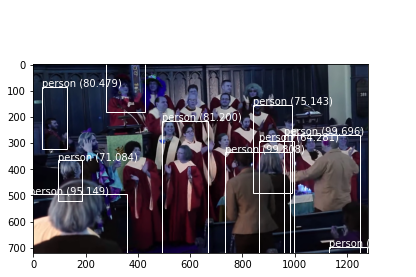

   Working on 245_8.mp4 frame 50 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.4760274887085
person 99.92477297782898
person 95.74039578437805
person 88.82430791854858
person 69.50855255126953
person 85.55561304092407
person 77.19699144363403
person 80.30351400375366
person 68.18729043006897
person 97.0710277557373
person 85.56604385375977


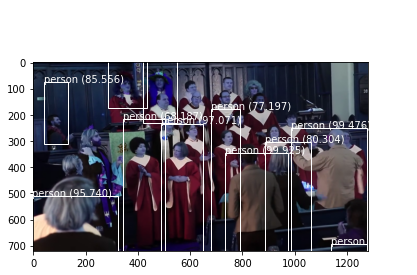

   Working on 245_8.mp4 frame 60 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.61392879486084
person 93.0509626865387
person 68.32678318023682
person 70.83054184913635
person 86.6044819355011
person 61.39277219772339
person 80.1847517490387
person 65.56206941604614
person 86.41377687454224
person 99.34382438659668
person 83.84636640548706
person 93.5401439666748
person 95.09906768798828
person 90.48184752464294


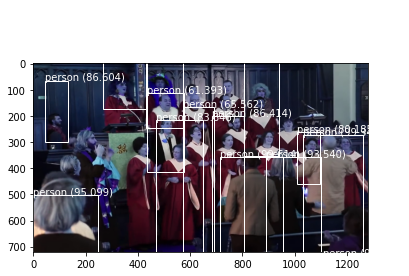

   Working on 245_8.mp4 frame 70 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 81.11542463302612
person 64.0446662902832
person 64.14632201194763
person 63.77619504928589
person 91.58753752708435
person 63.177067041397095
person 63.0806028842926
person 66.45170450210571
person 96.14369869232178
person 60.06008982658386
person 84.15312170982361
person 99.57236647605896
person 83.37141275405884
person 91.16942882537842


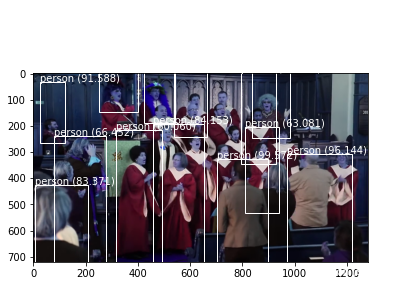

   Working on 245_8.mp4 frame 80 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.60281252861023
person 87.5796914100647
person 80.63344955444336
person 80.7801604270935
person 86.33394837379456
person 80.12832403182983
person 96.04161381721497
person 89.30103182792664
person 80.63679933547974
person 86.53596043586731
person 99.2917001247406
person 70.06493806838989
person 93.26701164245605
person 98.85794520378113
person 82.63493776321411
person 94.6168065071106


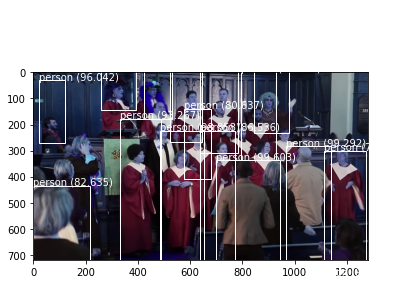

   Working on 245_8.mp4 frame 90 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.90054965019226
person 86.60734295845032
person 78.16290259361267
person 74.35927987098694
person 65.33007025718689
person 88.77638578414917
person 72.00825810432434
person 94.12514567375183
person 80.41004538536072
person 98.49156141281128
person 93.25935244560242
person 65.9888744354248
person 86.07386350631714
person 95.78322768211365


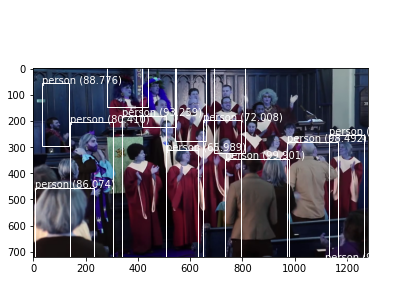

   Working on 245_8.mp4 frame 100 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.74818825721741
person 95.77077031135559
person 91.24417901039124
person 90.94581007957458
person 76.90080404281616
person 70.55253386497498
person 89.96675610542297
person 97.77413010597229
person 69.25579309463501
person 79.26062345504761
person 76.17553472518921


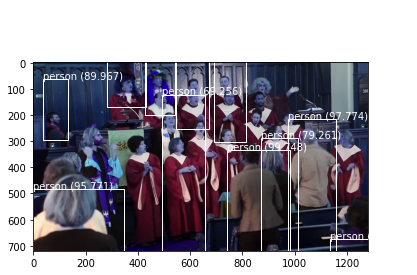

   Working on 245_8.mp4 frame 110 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.74050521850586
person 98.89637231826782
person 94.64005827903748
person 91.32242202758789
person 76.69909596443176
person 90.37862420082092
person 73.35012555122375
person 76.46128535270691
person 99.8293399810791
person 78.2284140586853
person 78.97332310676575
person 68.63740086555481
suitcase 84.12982225418091


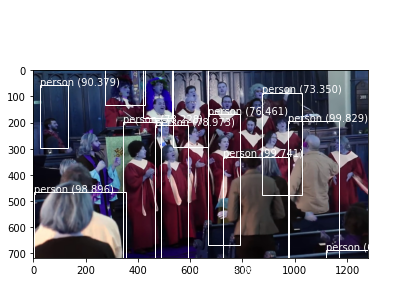

Processing video 0/10 with name 229_1.mp4

   Working on 229_1.mp4 frame 0 video num 0
Showing sample frame for 229_1.mp4 with shape (720, 1280, 3)
printing type image
<class 'numpy.ndarray'>
Original frame: 


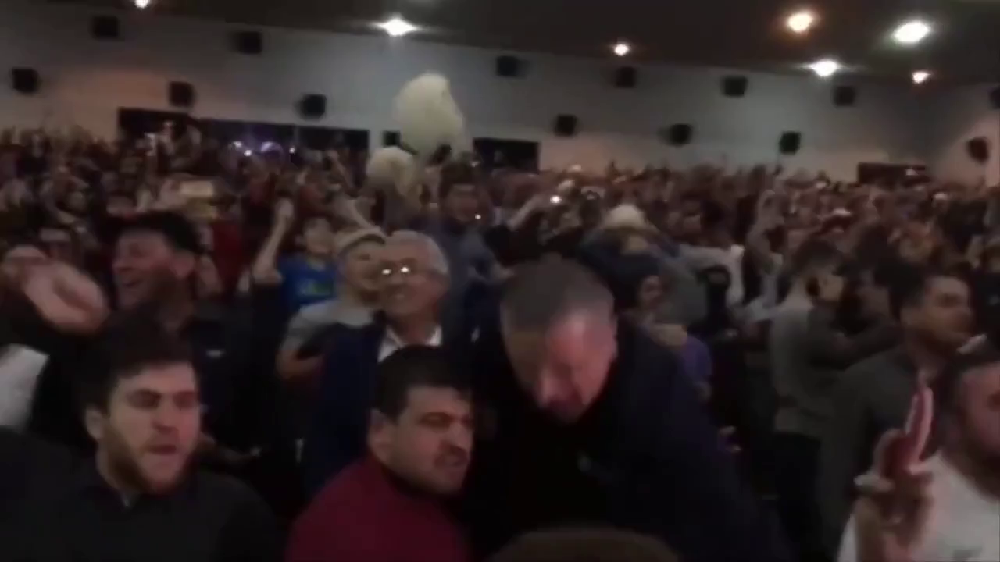


Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 80.88483810424805
person 80.44266104698181


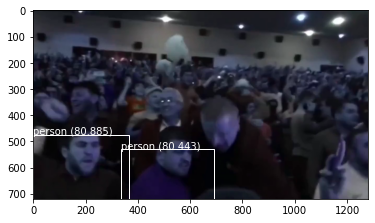

   Working on 229_1.mp4 frame 10 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 64.100581407547


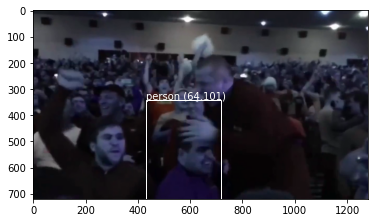

   Working on 229_1.mp4 frame 20 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 66.01885557174683


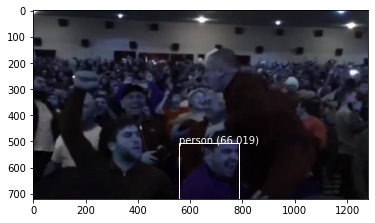

   Working on 229_1.mp4 frame 30 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 83.41531753540039
person 79.7546923160553


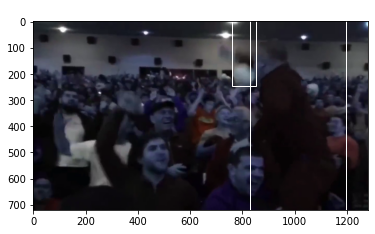

   Working on 229_1.mp4 frame 40 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]


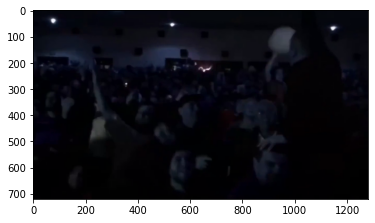

   Working on 229_1.mp4 frame 50 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]


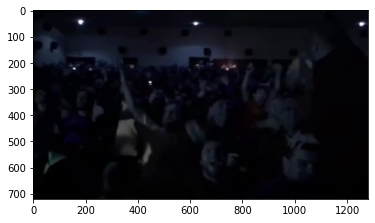

   Working on 229_1.mp4 frame 60 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]


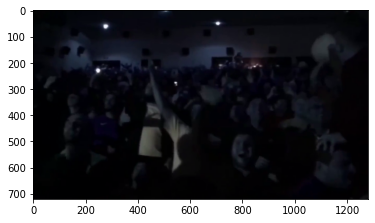

   Working on 229_1.mp4 frame 70 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]


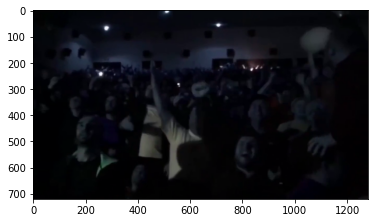

   Working on 229_1.mp4 frame 80 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 60.38157939910889


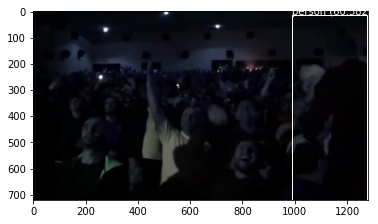

   Working on 229_1.mp4 frame 90 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 88.91195058822632


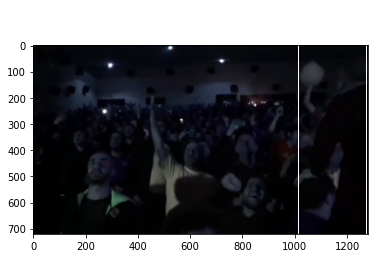

   Working on 229_1.mp4 frame 100 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]


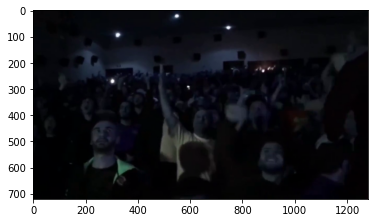

   Working on 229_1.mp4 frame 110 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]


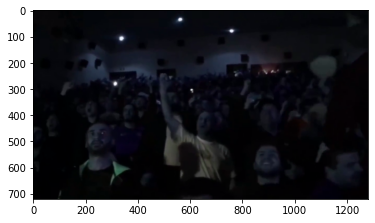

   Working on 229_1.mp4 frame 120 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]


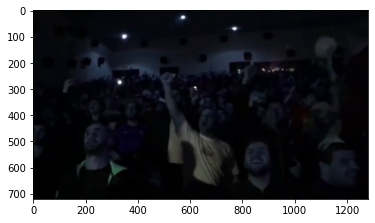

   Working on 229_1.mp4 frame 130 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]


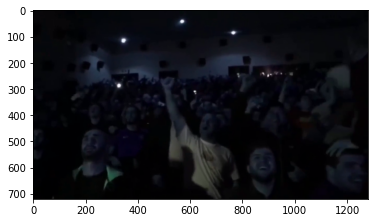

   Working on 229_1.mp4 frame 140 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]


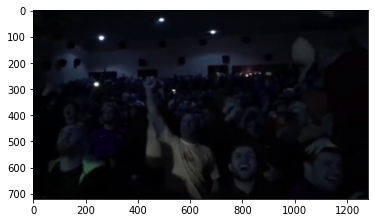

Processing video 0/10 with name 271_4.mp4

   Working on 271_4.mp4 frame 0 video num 0
Showing sample frame for 271_4.mp4 with shape (720, 1280, 3)
printing type image
<class 'numpy.ndarray'>
Original frame: 


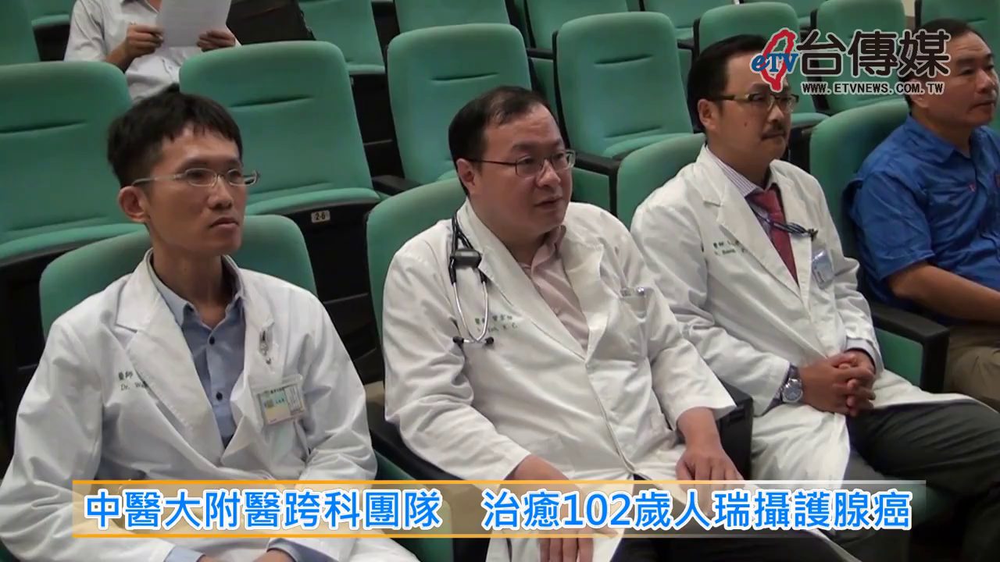


Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 80.08465766906738
chair 71.2945282459259
person 78.11501026153564
person 98.8982081413269
person 95.9021806716919
person 98.32392930984497
chair 95.36492228507996
chair 98.56162071228027
chair 99.07896518707275
chair 85.24619936943054
chair 73.27718734741211
chair 62.98249959945679


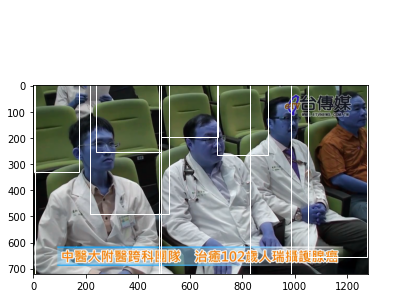

   Working on 271_4.mp4 frame 10 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 81.38668537139893
chair 68.33120584487915
person 82.07350373268127
person 98.46745133399963
person 95.13882398605347
person 98.08659553527832
chair 94.40697431564331
chair 63.84263634681702
chair 98.69898557662964
chair 99.35717582702637
chair 84.8936915397644
chair 73.9908218383789


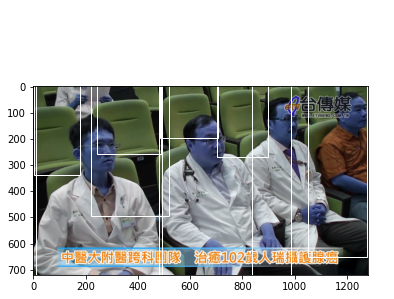

   Working on 271_4.mp4 frame 20 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 70.48043608665466
chair 62.016481161117554
person 84.24740433692932
person 98.01065921783447
person 94.13586854934692
person 97.77230024337769
chair 94.56437826156616
chair 98.82236123085022
chair 98.76902103424072
chair 86.7509663105011
chair 76.50459408760071
chair 65.26345014572144


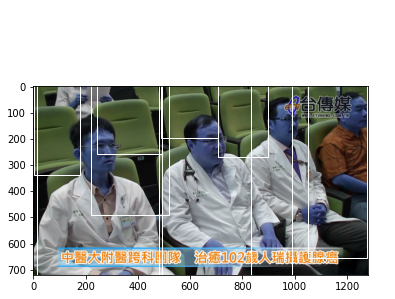

   Working on 271_4.mp4 frame 30 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 64.996337890625
chair 77.32346057891846
person 75.79612731933594
person 98.80114793777466
person 92.79548525810242
person 98.35747480392456
chair 92.47022867202759
chair 74.02424812316895
chair 99.21878576278687
chair 99.04612898826599
chair 85.41010618209839
chair 84.32438373565674
chair 66.80772304534912


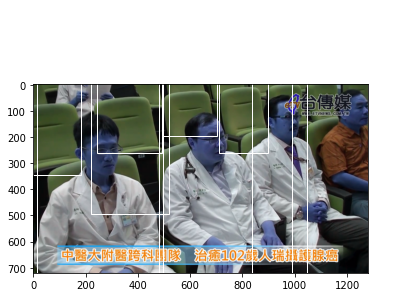

   Working on 271_4.mp4 frame 40 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
chair 81.7158579826355
person 79.49146628379822
person 98.74598979949951
person 92.99281239509583
person 99.10430908203125
chair 88.17618489265442
chair 66.8542742729187
chair 99.28566813468933
chair 99.00680184364319
chair 74.37267899513245
tie 61.44048571586609


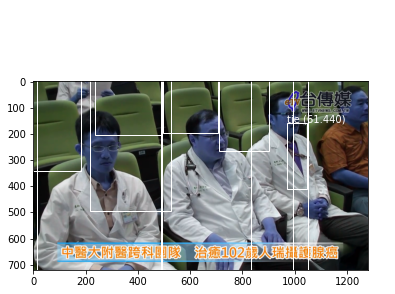

   Working on 271_4.mp4 frame 50 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 67.07617044448853
person 98.69980216026306
person 92.14926362037659
person 98.95527958869934
chair 90.00215530395508
chair 99.27438497543335
chair 98.78636598587036
chair 87.48688101768494
chair 74.64264035224915
tie 70.3978180885315


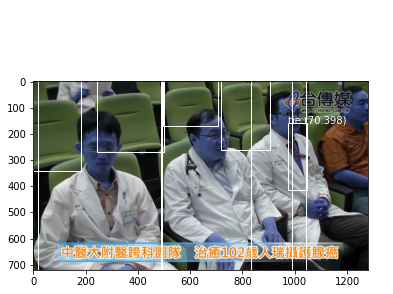

   Working on 271_4.mp4 frame 60 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]


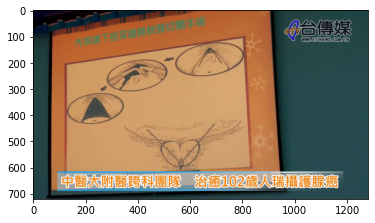

   Working on 271_4.mp4 frame 70 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]


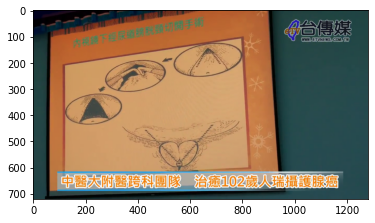

   Working on 271_4.mp4 frame 80 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]


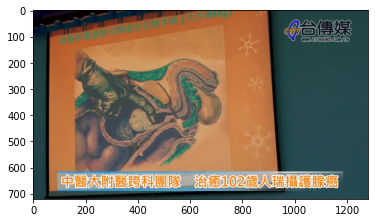

   Working on 271_4.mp4 frame 90 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]


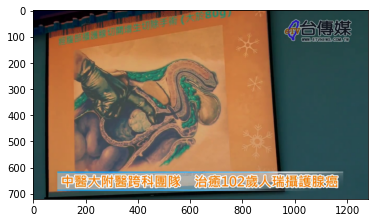

   Working on 271_4.mp4 frame 100 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]


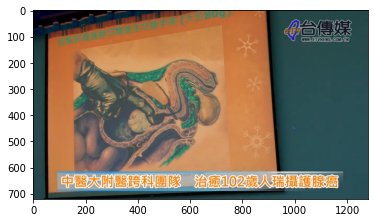

   Working on 271_4.mp4 frame 110 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]


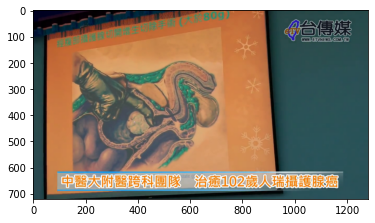

   Working on 271_4.mp4 frame 120 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]


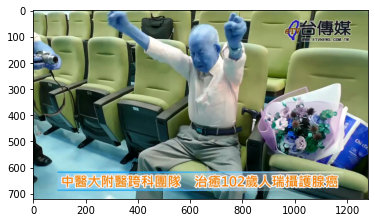

   Working on 271_4.mp4 frame 130 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
chair 61.63954734802246
chair 74.99238848686218
person 96.98893427848816
chair 82.45204091072083
chair 93.6460018157959
chair 69.3335235118866
chair 93.05582046508789
chair 64.28303718566895


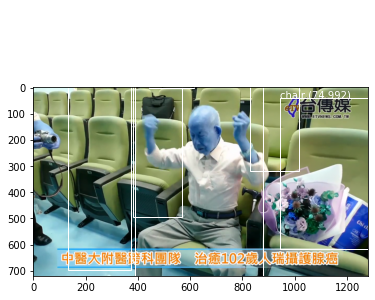

   Working on 271_4.mp4 frame 140 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
chair 82.67524242401123
person 83.17737579345703
chair 94.03810501098633
chair 65.81202745437622
chair 95.08522748947144
chair 91.12906455993652
chair 76.55931115150452
chair 86.23269200325012
chair 94.65278387069702
chair 90.17457365989685


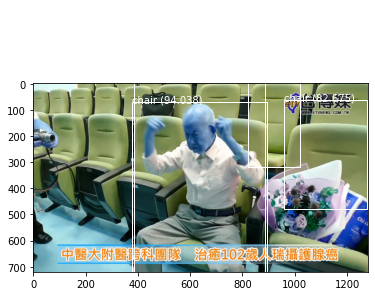

Processing video 0/10 with name 253_1.mp4

   Working on 253_1.mp4 frame 0 video num 0
Showing sample frame for 253_1.mp4 with shape (720, 1280, 3)
printing type image
<class 'numpy.ndarray'>
Original frame: 


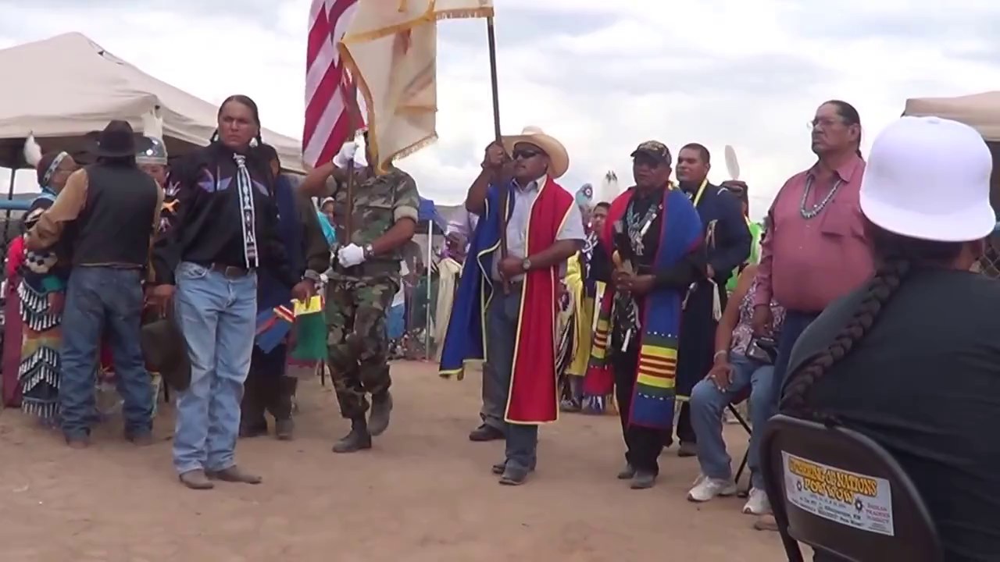


Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.17598366737366
person 82.60581493377686
person 99.25429224967957
person 98.3830451965332
person 98.92690181732178
person 61.159783601760864
person 81.8686842918396


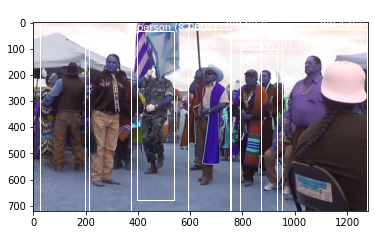

   Working on 253_1.mp4 frame 10 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 98.84154796600342
person 98.71474504470825
person 96.36164903640747
person 99.19463992118835
person 99.02852177619934
person 76.1966347694397
person 96.5746283531189


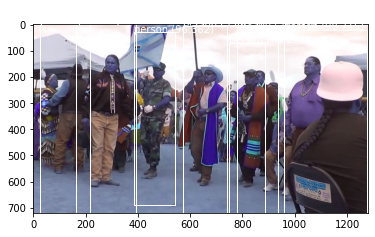

   Working on 253_1.mp4 frame 20 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.7736930847168
person 98.59906435012817
person 80.5411696434021
person 97.62440919876099
person 92.68785119056702
person 96.43145203590393


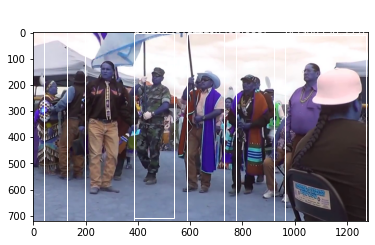

   Working on 253_1.mp4 frame 30 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.66490864753723
person 98.96753430366516
person 92.61530041694641
person 90.732342004776
person 98.13908338546753
person 99.15693998336792


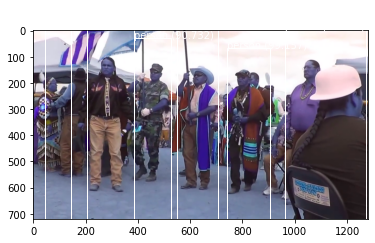

   Working on 253_1.mp4 frame 40 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 98.07484149932861
person 99.2447555065155
person 60.03568172454834
person 96.94045186042786
person 99.36685562133789
person 98.86653423309326
skateboard 63.141512870788574


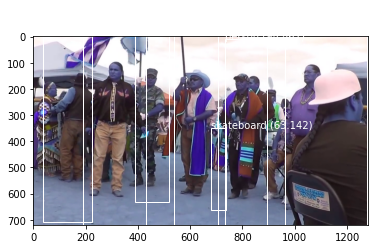

   Working on 253_1.mp4 frame 50 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.5360255241394
person 80.47361969947815
person 99.06418323516846
person 99.0022599697113
person 98.5317051410675
person 97.53973484039307


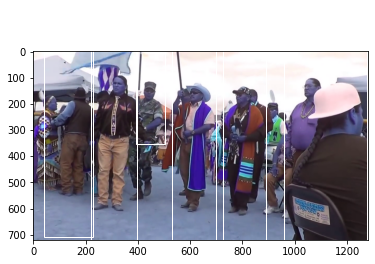

   Working on 253_1.mp4 frame 60 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.41905736923218
person 81.83806538581848
person 98.89170527458191
person 98.83147478103638
person 98.42944145202637
person 93.79444718360901
person 62.52431273460388


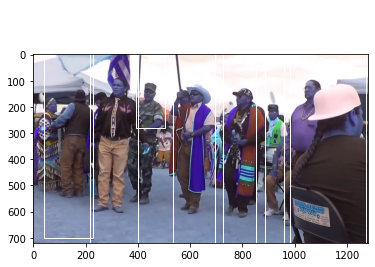

   Working on 253_1.mp4 frame 70 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.4673490524292
person 98.83427619934082
person 99.42124485969543
person 98.69586825370789
person 87.02202439308167
person 88.08131217956543


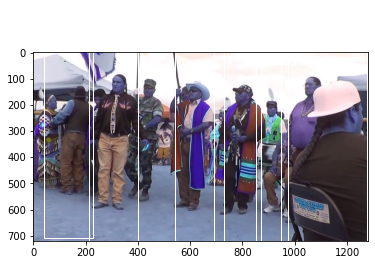

   Working on 253_1.mp4 frame 80 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 98.80716800689697
person 99.40996766090393
person 99.01928901672363
person 83.32828879356384
person 97.63344526290894
person 97.8241503238678
person 61.91474795341492


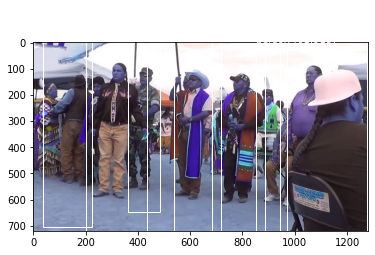

   Working on 253_1.mp4 frame 90 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 96.53228521347046
person 98.3451783657074
person 99.43402409553528
person 60.892391204833984
person 64.7420883178711
person 97.70283699035645
person 91.68692231178284


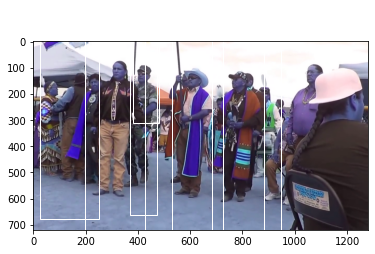

   Working on 253_1.mp4 frame 100 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 94.95924115180969
person 99.41031336784363
person 98.55906963348389
person 85.98458766937256
person 94.79647874832153
person 96.41433358192444


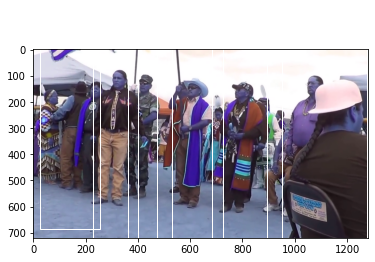

   Working on 253_1.mp4 frame 110 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 97.47856855392456
person 66.02436304092407
person 99.59403276443481
person 60.5859100818634
person 88.44998478889465
person 94.41775679588318
person 93.42731833457947


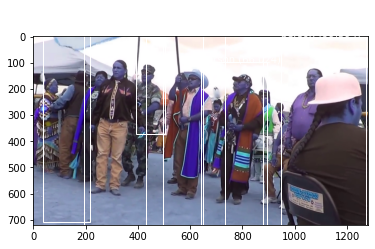

   Working on 253_1.mp4 frame 120 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 87.30828166007996
person 99.19124245643616
person 99.79928731918335
person 90.89038372039795
person 97.32914566993713
person 94.24977898597717
person 87.09003925323486


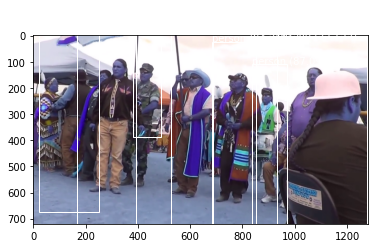

   Working on 253_1.mp4 frame 130 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 98.89722466468811
person 99.65626001358032
person 96.54883742332458
person 66.64532423019409
person 99.1815447807312
person 94.25439834594727
person 82.51762986183167


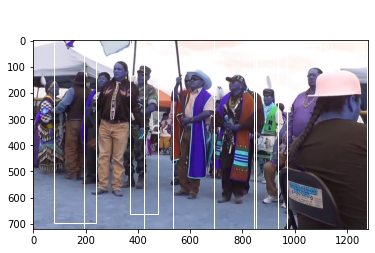

   Working on 253_1.mp4 frame 140 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.4410753250122
person 60.282498598098755
person 76.65899395942688
person 95.79806923866272
person 97.50590324401855
person 93.18327903747559


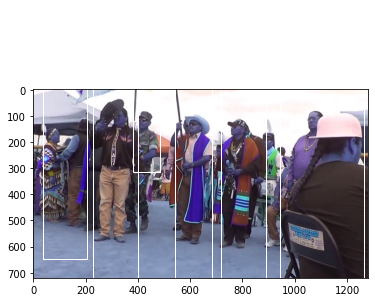

Processing video 0/10 with name 225_2.mp4

   Working on 225_2.mp4 frame 0 video num 0
Showing sample frame for 225_2.mp4 with shape (360, 480, 3)
printing type image
<class 'numpy.ndarray'>
Original frame: 


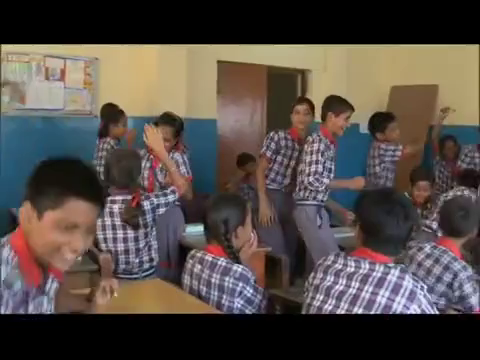


Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 92.91213154792786
person 87.37876415252686
person 99.85133409500122
person 64.81674909591675
person 95.92528343200684


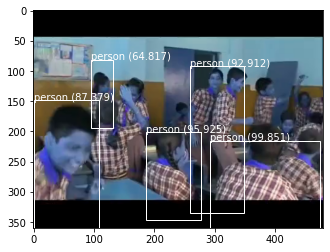

   Working on 225_2.mp4 frame 10 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 98.09324145317078
person 99.23824667930603
person 89.67368602752686
person 71.27096056938171
person 93.17212700843811
person 64.45117592811584
person 88.12311887741089
person 97.54769206047058


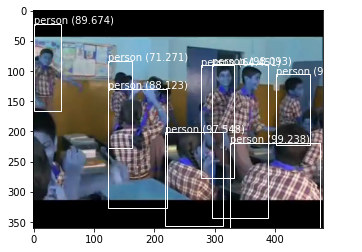

   Working on 225_2.mp4 frame 20 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 97.20985293388367
person 93.9109742641449
person 64.06713724136353
person 98.26816320419312
person 93.17411780357361
person 75.70128440856934
person 89.49042558670044


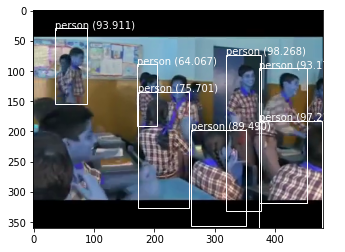

   Working on 225_2.mp4 frame 30 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 82.31616616249084
person 81.68678879737854
person 98.79259467124939
person 85.37871837615967
person 76.72539353370667
person 88.31161260604858


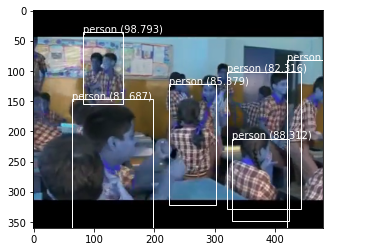

   Working on 225_2.mp4 frame 40 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.44310784339905
person 98.52479100227356
person 89.8425817489624
person 89.49482440948486
person 95.13216018676758
person 64.66249227523804


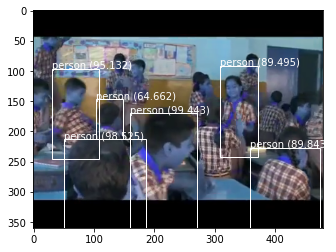

   Working on 225_2.mp4 frame 50 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 98.77076148986816
person 91.79568290710449
person 96.10929489135742
person 91.89348816871643
person 62.53312826156616
person 62.030571699142456
person 92.6493227481842
person 79.867422580719


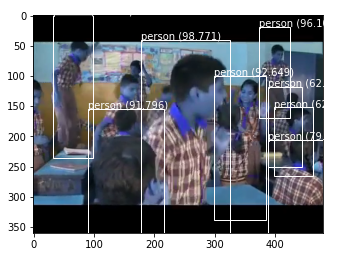

   Working on 225_2.mp4 frame 60 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 98.95535707473755
person 94.2947506904602
person 99.7865617275238
person 74.47019219398499
person 98.40619564056396
person 96.80104851722717
person 63.4701669216156
person 80.94143867492676
person 81.22451901435852


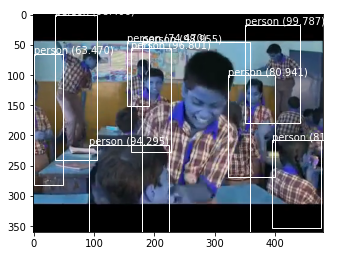

   Working on 225_2.mp4 frame 70 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 84.13453102111816
person 64.29256796836853
person 88.98268342018127
person 99.40707683563232
person 96.88864946365356
person 99.46418404579163
person 96.1847722530365
person 97.63940572738647
person 80.92327117919922


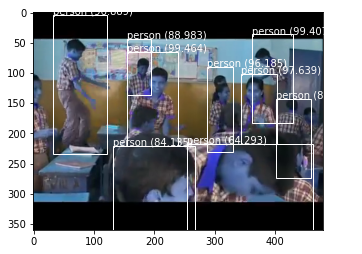

   Working on 225_2.mp4 frame 80 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 97.3307192325592
person 69.60695385932922
person 83.15401077270508
person 82.69286751747131
person 94.52499747276306
person 82.9072892665863
person 72.09451794624329
person 86.61105036735535
person 97.41644263267517
person 95.82791924476624
person 90.21772146224976


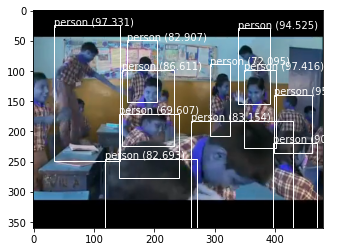

   Working on 225_2.mp4 frame 90 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.15710687637329
person 97.17552661895752
person 79.73760962486267
person 67.48449206352234
person 92.70972013473511
person 93.40672492980957
person 95.02268433570862
person 73.80473613739014
person 90.33120274543762
person 67.3603355884552


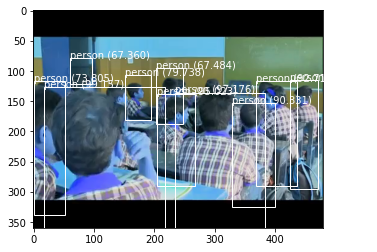

   Working on 225_2.mp4 frame 100 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 97.94650673866272
person 98.88202548027039
person 90.82021117210388
person 91.12043976783752
person 88.99996876716614
person 95.1988697052002
backpack 60.01221537590027
person 66.9431209564209


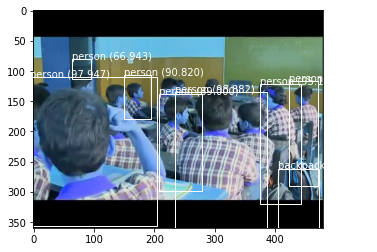

   Working on 225_2.mp4 frame 110 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 97.1850335597992
person 98.88592958450317
person 68.02709698677063
person 89.663565158844
person 92.68792867660522
person 90.12721180915833
person 94.82533931732178
backpack 63.85990381240845
person 90.84803462028503
person 73.38730692863464


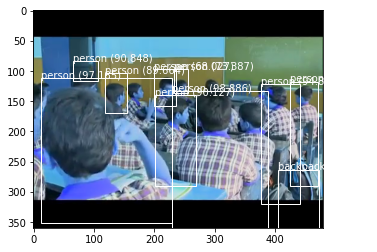

   Working on 225_2.mp4 frame 120 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.0185022354126
person 98.66235852241516
person 81.74688220024109
person 91.12540483474731
person 86.23908758163452
person 64.00387287139893
person 89.649897813797
person 93.66616010665894
person 73.33880066871643
person 94.71275806427002
backpack 60.91509461402893
person 76.13586783409119
person 80.7030439376831


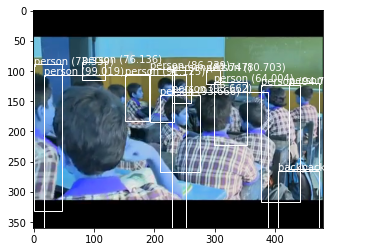

Processing video 0/10 with name 215_5.mp4

   Working on 215_5.mp4 frame 0 video num 0
Showing sample frame for 215_5.mp4 with shape (360, 640, 3)
printing type image
<class 'numpy.ndarray'>
Original frame: 


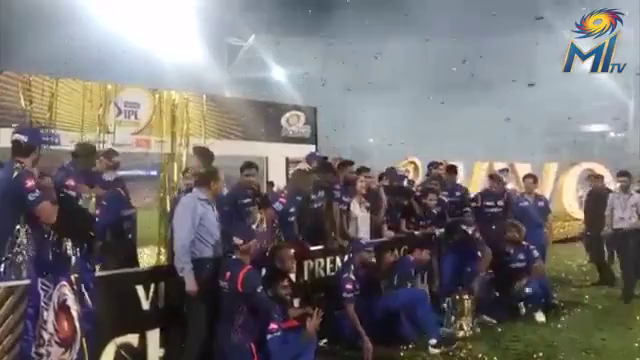


Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 66.26222729682922
person 90.7666563987732
person 82.55959153175354
person 91.64854884147644


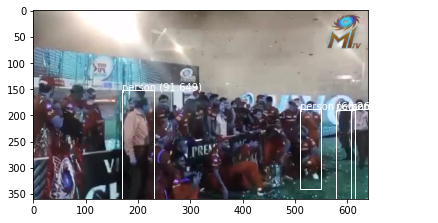

   Working on 215_5.mp4 frame 10 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 97.80157804489136
person 89.89264965057373
person 96.09177708625793


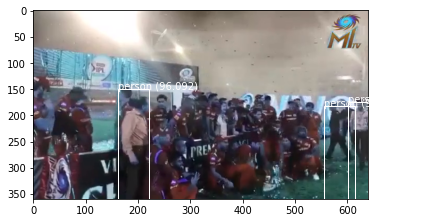

   Working on 215_5.mp4 frame 20 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 93.37574243545532
person 77.62623429298401
person 80.18838763237


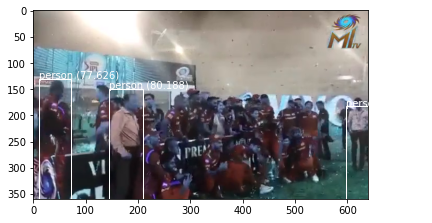

   Working on 215_5.mp4 frame 30 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 61.862802505493164
person 91.41577482223511
person 83.61672759056091
person 95.1814591884613


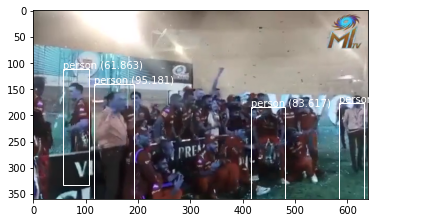

   Working on 215_5.mp4 frame 40 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 65.61115384101868
person 82.51155018806458
person 96.33171558380127
horse 87.31905817985535


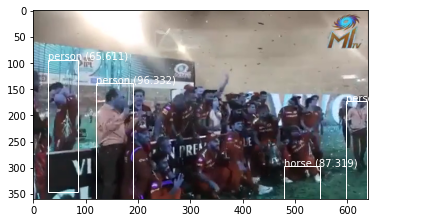

   Working on 215_5.mp4 frame 50 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 72.49425053596497
person 73.83415102958679
person 86.14144921302795
person 98.52641224861145


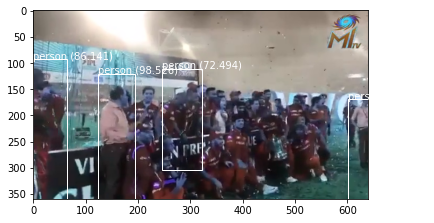

   Working on 215_5.mp4 frame 60 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 65.73217511177063
person 80.89771270751953
person 98.19405674934387
horse 79.82518076896667


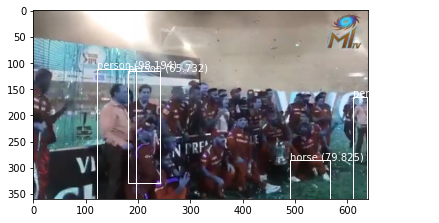

   Working on 215_5.mp4 frame 70 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 73.51881861686707
person 90.13637900352478


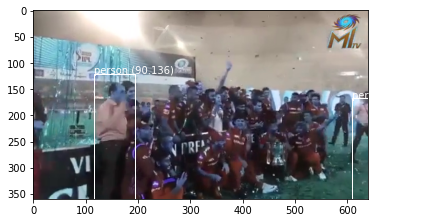

   Working on 215_5.mp4 frame 80 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 69.02799010276794
person 93.50024461746216


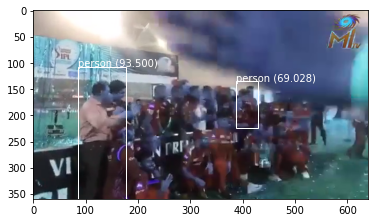

   Working on 215_5.mp4 frame 90 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 60.377830266952515
person 72.22607731819153
person 90.73798060417175


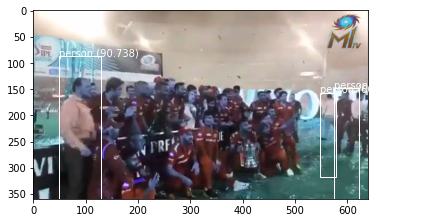

   Working on 215_5.mp4 frame 100 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 83.61440300941467
person 95.57037353515625
person 97.52122163772583


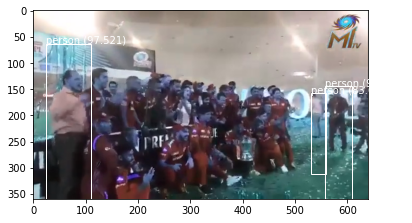

   Working on 215_5.mp4 frame 110 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 63.012778759002686
person 99.62906837463379
person 96.31489515304565
horse 81.6654622554779


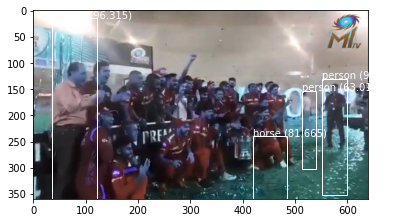

Processing video 0/10 with name 229_3.mp4

   Working on 229_3.mp4 frame 0 video num 0
Showing sample frame for 229_3.mp4 with shape (720, 1280, 3)
printing type image
<class 'numpy.ndarray'>
Original frame: 


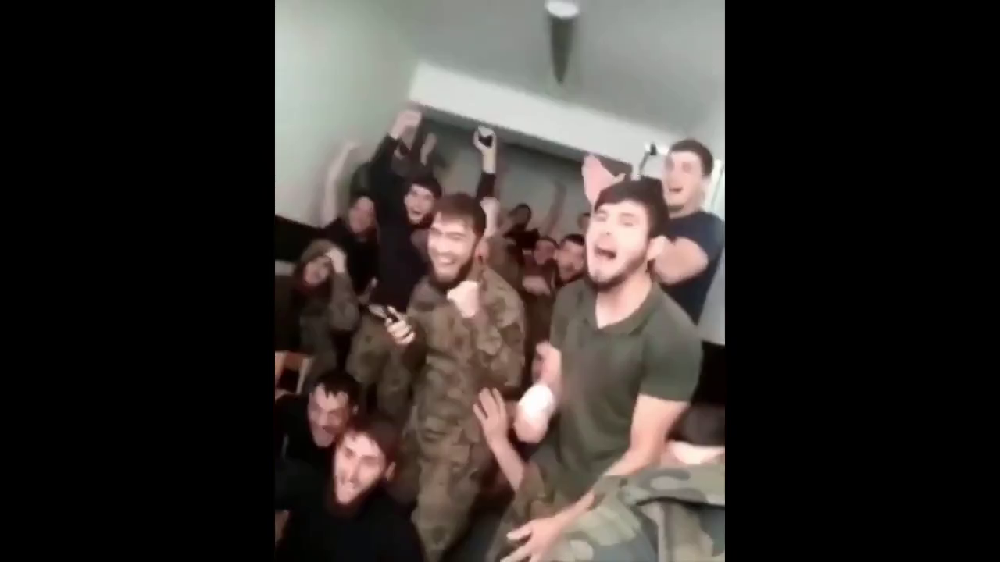


Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 62.543100118637085
person 96.62876725196838


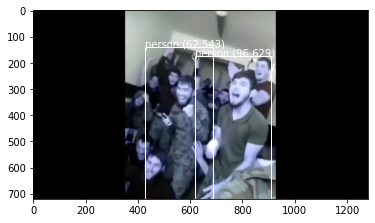

   Working on 229_3.mp4 frame 10 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 62.1178925037384


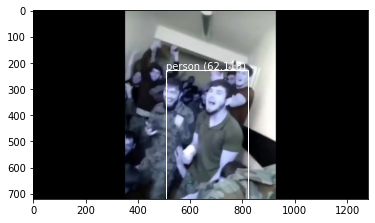

   Working on 229_3.mp4 frame 20 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]


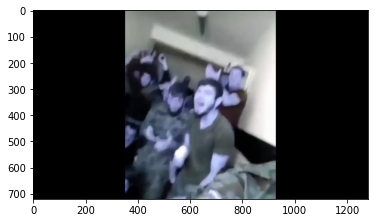

   Working on 229_3.mp4 frame 30 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]


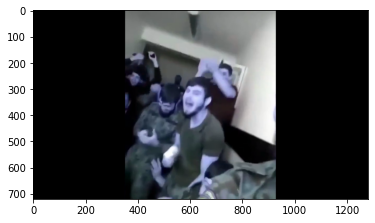

   Working on 229_3.mp4 frame 40 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
dog 78.91619801521301
person 69.89243030548096


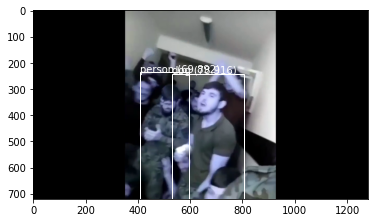

   Working on 229_3.mp4 frame 50 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 97.16503024101257
person 77.76603698730469


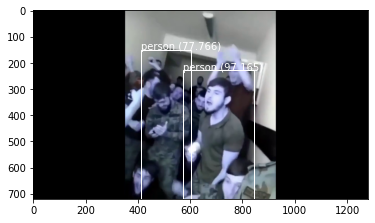

   Working on 229_3.mp4 frame 60 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 95.80548405647278
person 82.69332647323608
person 75.14035701751709
person 86.39561533927917
person 96.94870114326477
person 65.15236496925354


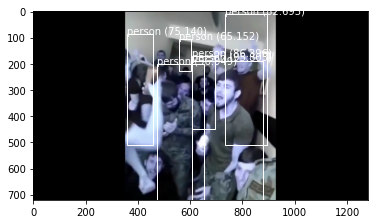

   Working on 229_3.mp4 frame 70 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 97.52233624458313
person 84.71654653549194


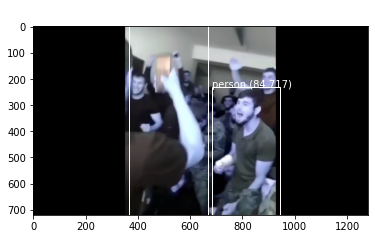

   Working on 229_3.mp4 frame 80 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 61.92546486854553
person 94.53719854354858


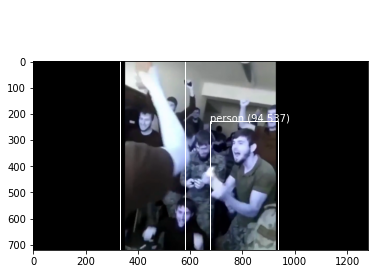

   Working on 229_3.mp4 frame 90 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]


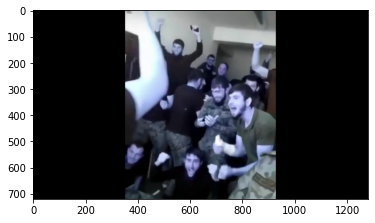

   Working on 229_3.mp4 frame 100 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 81.22387528419495
person 77.74822115898132
person 87.01841235160828


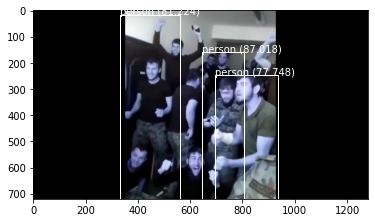

   Working on 229_3.mp4 frame 110 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 87.85879611968994


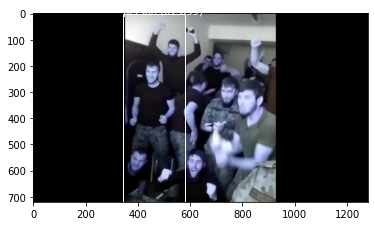

   Working on 229_3.mp4 frame 120 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 73.95321130752563
person 66.6967511177063


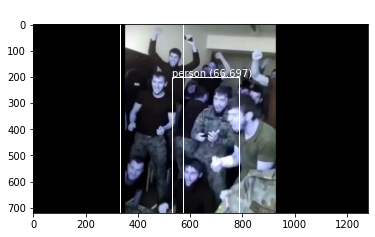

   Working on 229_3.mp4 frame 130 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 69.64463591575623


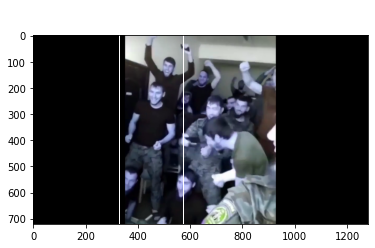

   Working on 229_3.mp4 frame 140 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 85.32721400260925
person 77.00334191322327
person 91.24341607093811


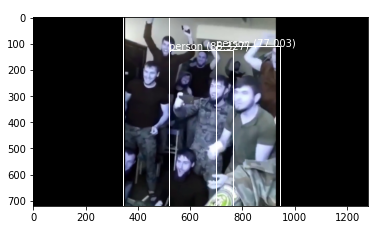

Processing video 0/10 with name 245_14.mp4

   Working on 245_14.mp4 frame 0 video num 0
Showing sample frame for 245_14.mp4 with shape (720, 1280, 3)
printing type image
<class 'numpy.ndarray'>
Original frame: 


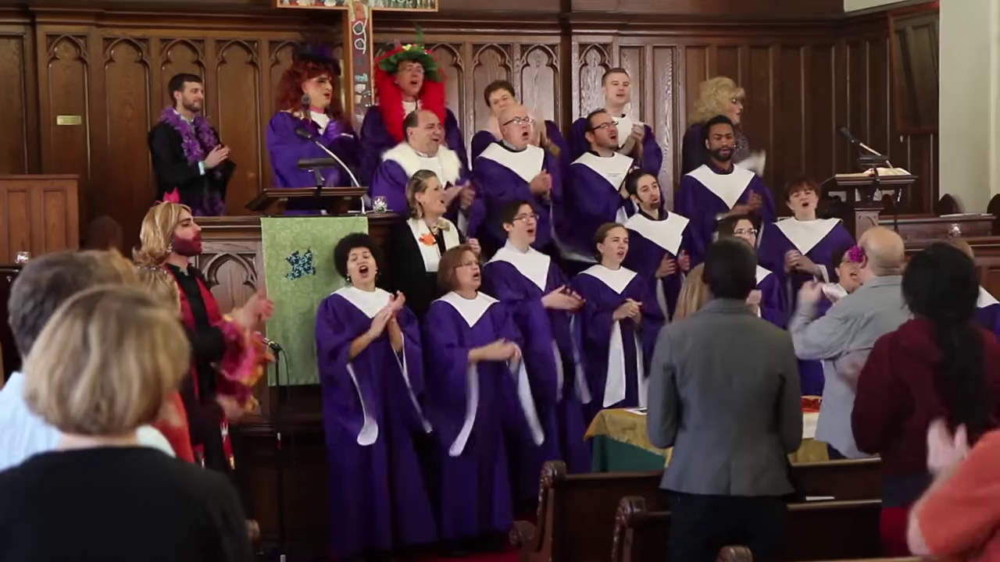


Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 95.11970281600952
person 90.33322930335999
person 92.8315818309784
person 84.04175639152527
person 99.31403398513794
person 79.011470079422


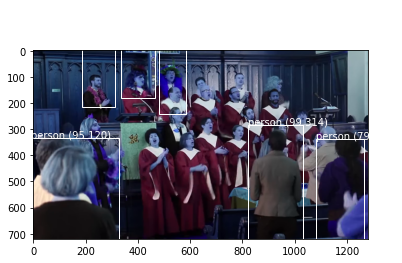

   Working on 245_14.mp4 frame 10 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 93.40333342552185
person 99.38623309135437
person 60.404348373413086
person 94.37761902809143
person 90.41067957878113
person 94.36092972755432
person 79.49129343032837
person 71.07767462730408
person 65.34894704818726
person 83.40058326721191
person 93.06154251098633
person 76.73472762107849
person 99.22869205474854


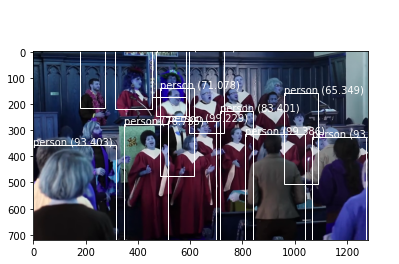

   Working on 245_14.mp4 frame 20 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 98.40404987335205
person 72.78163433074951
person 64.19121623039246
person 91.03472828865051
person 87.91908025741577
person 99.69833493232727
person 98.8179862499237


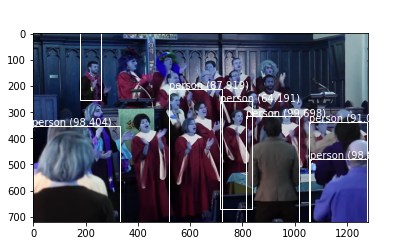

   Working on 245_14.mp4 frame 30 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 98.98853898048401
person 99.80998039245605
person 60.03560423851013
person 80.07592558860779
person 71.86077833175659
person 67.76151657104492
person 78.77920866012573
person 93.31991672515869
person 71.68102860450745
person 71.76387310028076
person 99.17457103729248


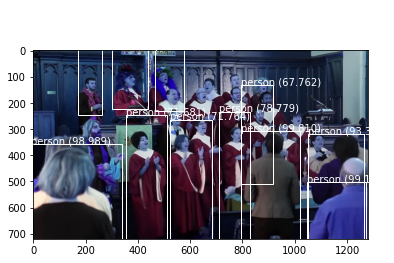

   Working on 245_14.mp4 frame 40 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 94.77453827857971
person 99.95679259300232
person 81.44278526306152
person 83.42016935348511
person 62.05105781555176
person 63.31207752227783
person 96.8145489692688
person 86.28481030464172


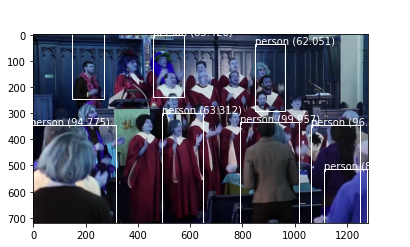

   Working on 245_14.mp4 frame 50 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 94.73305344581604
person 87.84713745117188
person 87.82350420951843
person 73.36520552635193
person 78.04098725318909
person 86.15868091583252
person 77.56652235984802
person 99.49328303337097
person 86.9304358959198


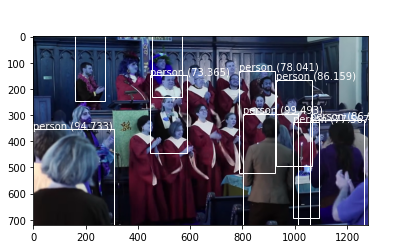

   Working on 245_14.mp4 frame 60 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 98.2908308506012
person 99.88764524459839
person 93.58992576599121
person 95.83617448806763
person 88.61421942710876
person 82.74735808372498
person 79.50050234794617
person 70.90420722961426
person 91.8180763721466
person 98.05925488471985
person 97.45073318481445
person 62.91236877441406


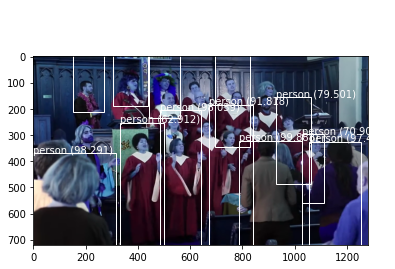

   Working on 245_14.mp4 frame 70 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 98.47026467323303
person 99.83155131340027
person 64.56603407859802
person 90.9558653831482
person 98.89664053916931


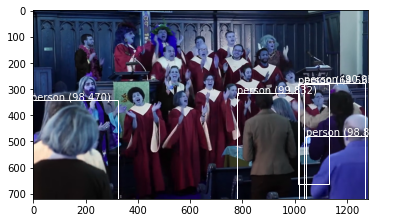

   Working on 245_14.mp4 frame 80 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.27873015403748
person 99.89915490150452
person 64.57642912864685
person 91.15573763847351
person 64.50660824775696
person 78.0421495437622
person 84.63431000709534
person 92.79950261116028
person 88.7590765953064
person 97.49723076820374


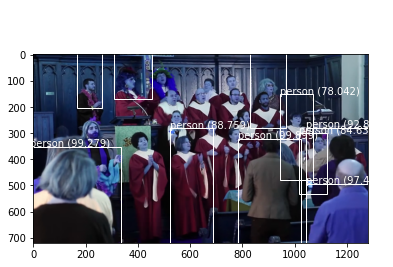

   Working on 245_14.mp4 frame 90 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 98.0478823184967
person 99.95788931846619
person 94.37323808670044
person 93.69354844093323
person 93.4128999710083
person 85.32000184059143
person 92.0217514038086
person 86.22580170631409
person 64.88265991210938
person 94.97364163398743
person 80.8570384979248
person 83.66468548774719
person 89.11768794059753


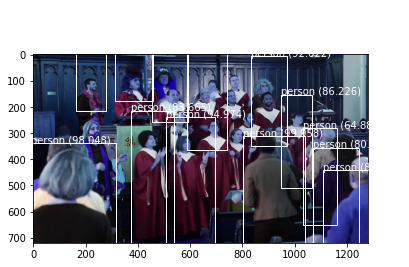

   Working on 245_14.mp4 frame 100 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 98.90429973602295
person 99.6778130531311
person 74.48374629020691
person 83.16490650177002
person 61.172276735305786
person 78.94136309623718
person 94.09103989601135
person 73.47742915153503


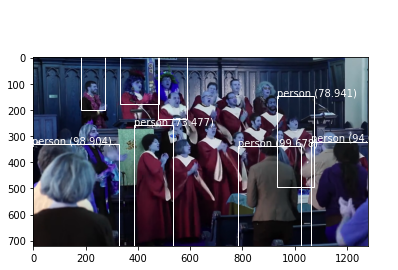

   Working on 245_14.mp4 frame 110 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.06680583953857
person 98.53988289833069
person 95.17173171043396
person 67.14829206466675
person 94.53990459442139
person 95.59699296951294
person 87.94543147087097
person 64.18628692626953
person 92.54322648048401
person 82.68224000930786
person 76.38605237007141
person 89.79214429855347
person 93.68179440498352
person 79.42242622375488


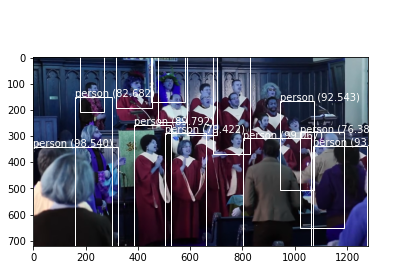

Processing video 0/10 with name 216_11.mp4

   Working on 216_11.mp4 frame 0 video num 0
Showing sample frame for 216_11.mp4 with shape (720, 1280, 3)
printing type image
<class 'numpy.ndarray'>
Original frame: 


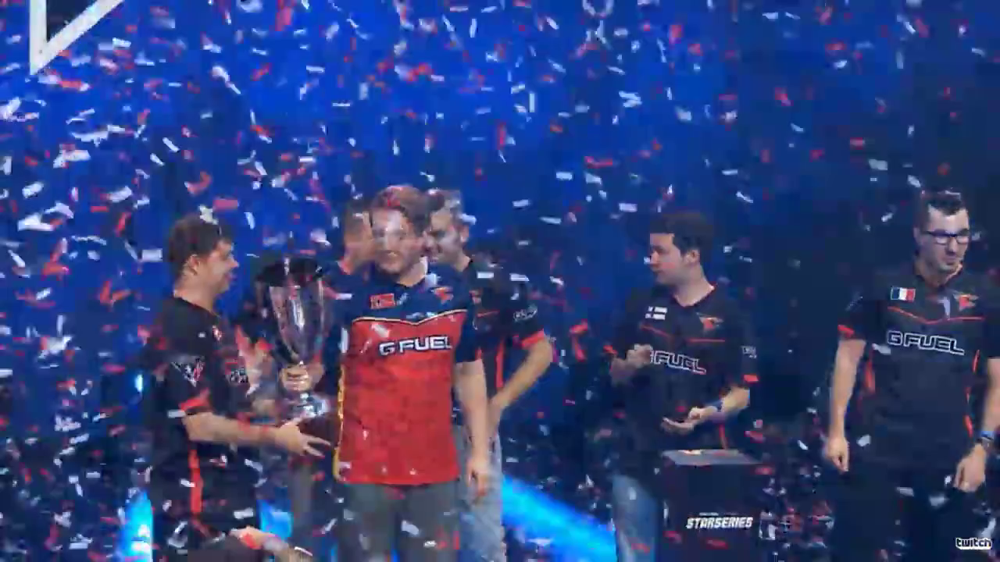


Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]


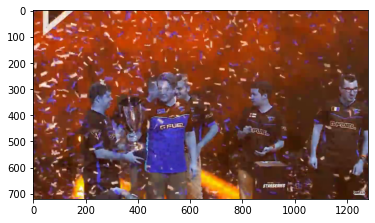

   Working on 216_11.mp4 frame 10 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 81.10703825950623
person 80.93242049217224
person 88.58248591423035


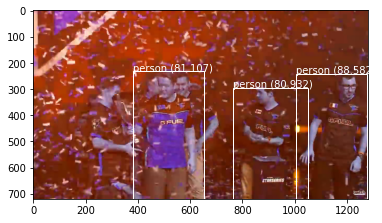

   Working on 216_11.mp4 frame 20 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 97.63343930244446
person 90.73144197463989


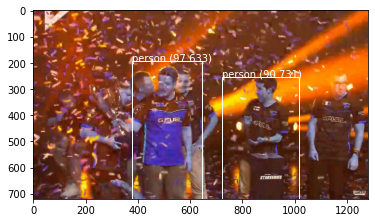

   Working on 216_11.mp4 frame 30 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]


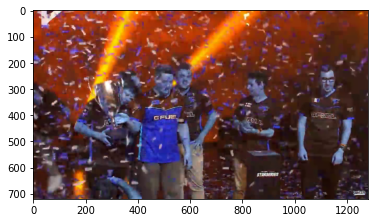

   Working on 216_11.mp4 frame 40 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]


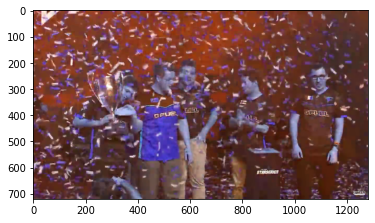

   Working on 216_11.mp4 frame 50 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]


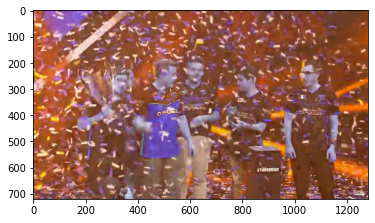

   Working on 216_11.mp4 frame 60 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]


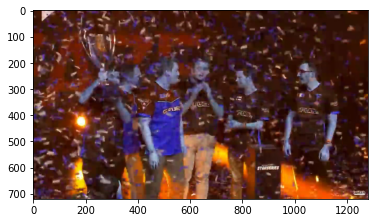

   Working on 216_11.mp4 frame 70 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]


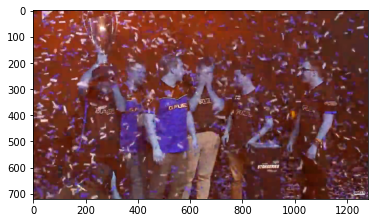

   Working on 216_11.mp4 frame 80 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]


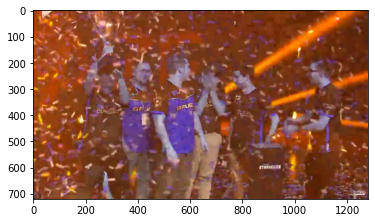

   Working on 216_11.mp4 frame 90 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]


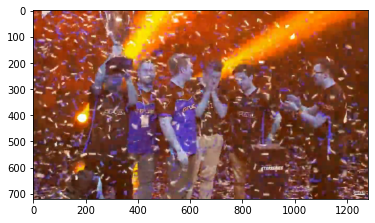

   Working on 216_11.mp4 frame 100 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]


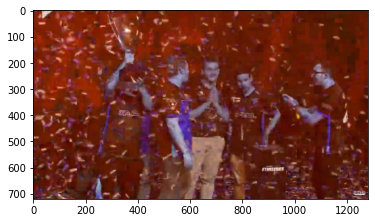

   Working on 216_11.mp4 frame 110 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]


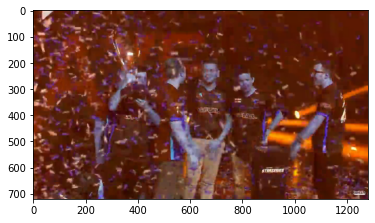

   Working on 216_11.mp4 frame 120 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]


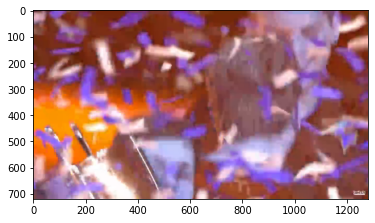

   Working on 216_11.mp4 frame 130 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]


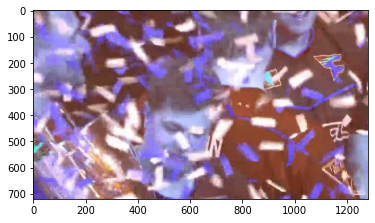

   Working on 216_11.mp4 frame 140 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]


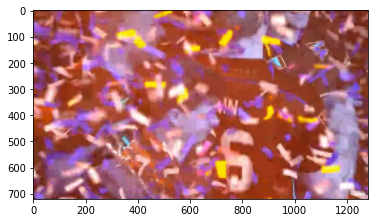

Processing video 0/10 with name 221_9.mp4

   Working on 221_9.mp4 frame 0 video num 0
Showing sample frame for 221_9.mp4 with shape (720, 1280, 3)
printing type image
<class 'numpy.ndarray'>
Original frame: 


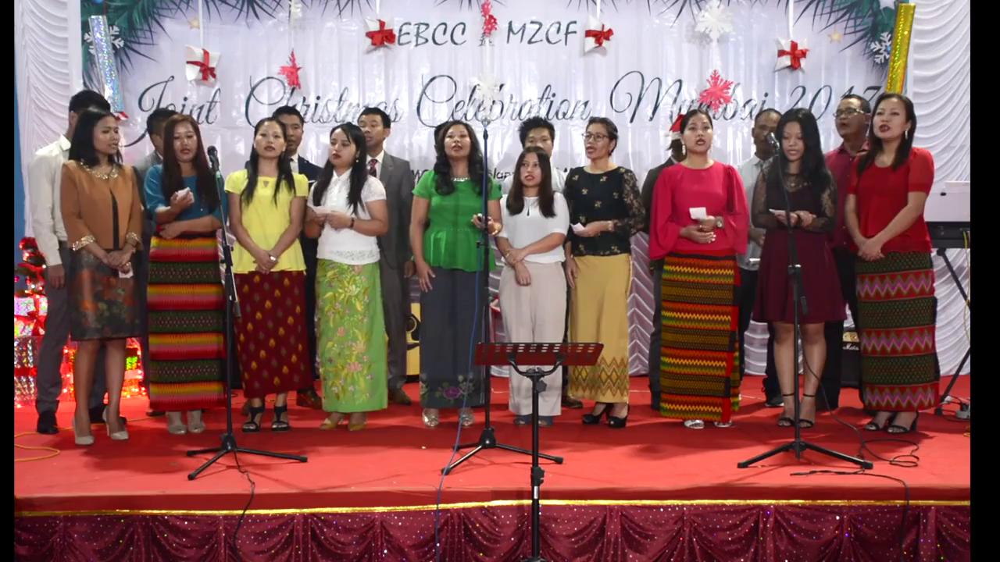


Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 62.99421191215515
person 87.67202496528625
person 99.76119995117188
person 97.78969883918762
person 99.52060580253601
person 99.53543543815613
person 89.61421251296997
person 99.67716336250305
person 96.02420330047607
person 98.20132255554199


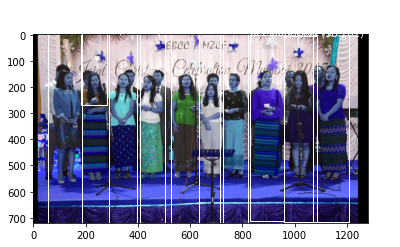

   Working on 221_9.mp4 frame 10 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 70.43006420135498
person 78.27823162078857
person 99.41771030426025
person 99.5505690574646
person 99.26619529724121
person 92.0025110244751
person 99.48251843452454
person 97.32568264007568
person 96.07587456703186
person 96.76417112350464


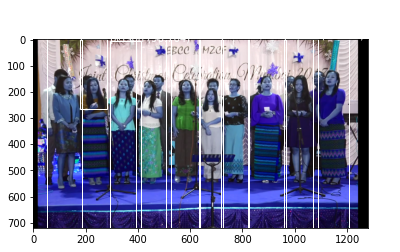

   Working on 221_9.mp4 frame 20 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 64.43652510643005
person 99.78968501091003
person 99.68630075454712
person 94.52136158943176
person 99.58627223968506
person 95.55989503860474
person 86.76032423973083
person 99.22108054161072
person 97.38891124725342


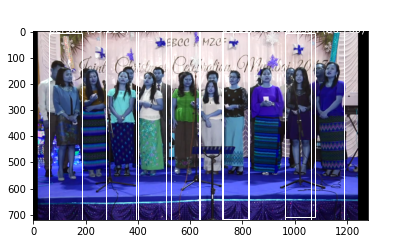

   Working on 221_9.mp4 frame 30 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 64.54352736473083
person 82.93448686599731
person 99.56388473510742
person 98.88045191764832
person 99.84877705574036
person 99.58539009094238
person 93.71475577354431
person 99.41938519477844
person 95.13429403305054
person 91.67843461036682


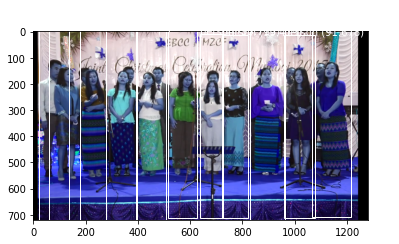

   Working on 221_9.mp4 frame 40 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 65.12464880943298
person 99.64292645454407
person 97.54934310913086
person 99.6895968914032
person 99.77508783340454
person 92.51924753189087
person 98.70399832725525
person 96.99363708496094
person 93.04447770118713
person 81.32774233818054


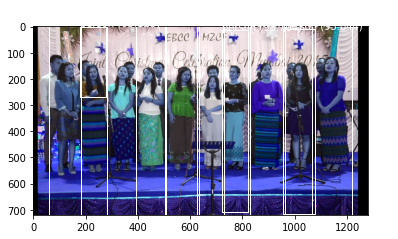

   Working on 221_9.mp4 frame 50 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 64.06136155128479
person 99.46892261505127
person 96.3533341884613
person 99.41766262054443
person 99.49100017547607
person 95.68271040916443
person 99.2471992969513
person 96.52354717254639
person 88.22680115699768
person 61.43006682395935


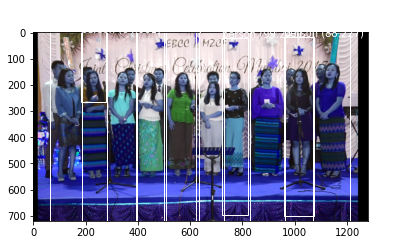

   Working on 221_9.mp4 frame 60 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 65.28815031051636
person 62.84558176994324
person 99.47482347488403
person 95.07516622543335
person 99.13588166236877
person 99.19324517250061
person 97.3850429058075
person 99.35930371284485
person 97.31569290161133
person 92.97722578048706


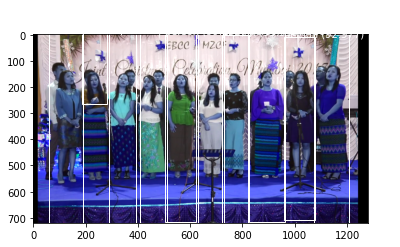

   Working on 221_9.mp4 frame 70 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 67.51847863197327
person 78.45178246498108
person 99.79087114334106
person 98.7851619720459
person 99.41002130508423
person 99.56409335136414
person 91.72296524047852
person 99.22220706939697
person 97.71041870117188
person 93.96324753761292


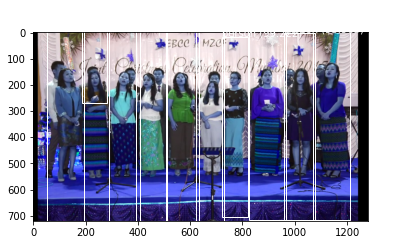

   Working on 221_9.mp4 frame 80 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 68.57547760009766
person 99.51362013816833
person 98.1363832950592
person 99.57486391067505
person 91.50989651679993
person 99.57874417304993
person 98.56509566307068
person 90.58407545089722
person 72.92695641517639
person 97.06931114196777


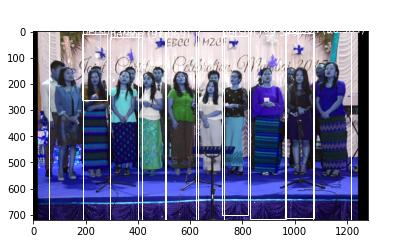

   Working on 221_9.mp4 frame 90 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 74.27675127983093
person 85.79848408699036
person 99.58249926567078
person 99.33955669403076
person 99.50652122497559
person 77.9492735862732
person 99.46321249008179
person 93.34896206855774
person 91.02560877799988
person 98.54846596717834


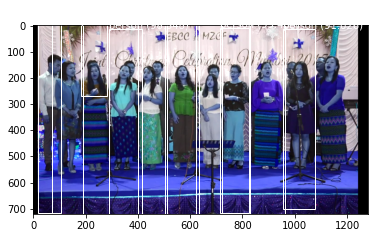

   Working on 221_9.mp4 frame 100 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 74.74061250686646
person 89.74679112434387
person 99.35649633407593
person 99.59980249404907
person 98.76089096069336
person 82.6807975769043
person 99.50500726699829
person 96.00831866264343
person 87.21951842308044
person 97.82902002334595


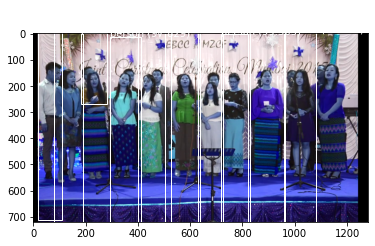

   Working on 221_9.mp4 frame 110 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 75.03461241722107
person 82.90857076644897
person 60.20321846008301
person 87.6991868019104
person 99.55314993858337
person 96.8207597732544
person 99.74481463432312
person 97.57353663444519
person 99.43755269050598
person 95.83580493927002
person 88.93020153045654


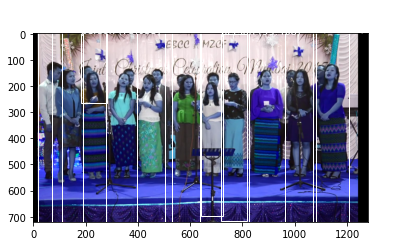

Processing video 0/10 with name 260_3.mp4

   Working on 260_3.mp4 frame 0 video num 0
Showing sample frame for 260_3.mp4 with shape (720, 1280, 3)
printing type image
<class 'numpy.ndarray'>
Original frame: 


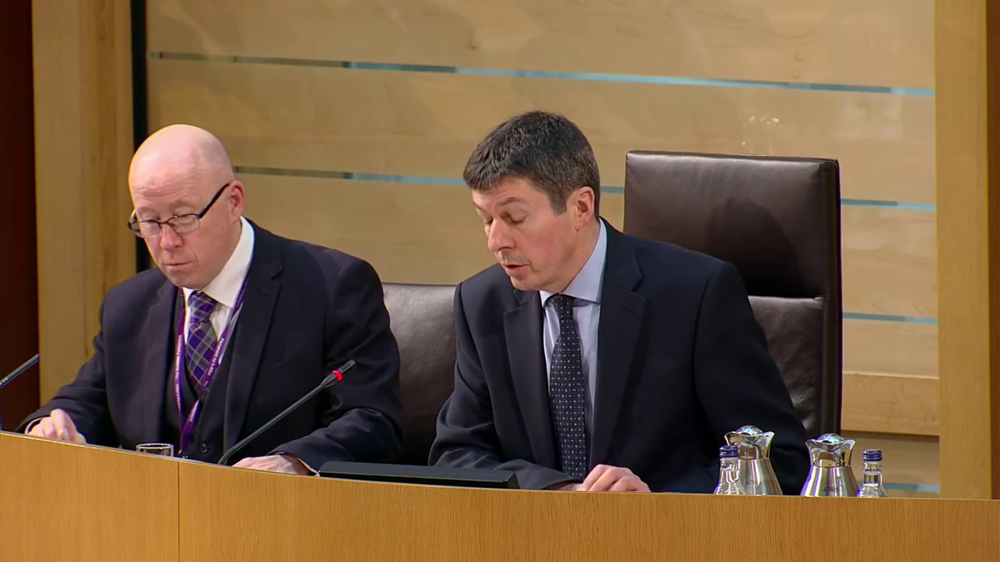


Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.83840584754944
person 97.90138602256775
tie 89.95009064674377
tie 98.33412766456604
bottle 66.16743803024292
bottle 62.70723342895508
bottle 64.91518020629883


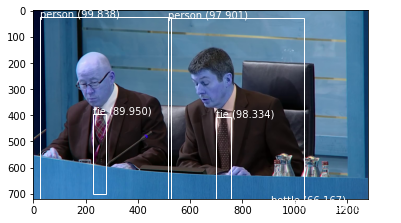

   Working on 260_3.mp4 frame 10 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.86676573753357
person 98.53733777999878
tie 91.98302626609802
tie 94.60780024528503
bottle 80.71606755256653
bottle 61.016422510147095


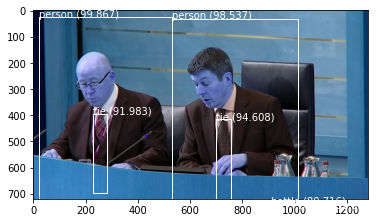

   Working on 260_3.mp4 frame 20 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.81071352958679
person 97.17833399772644
tie 92.09427833557129
tie 93.0867075920105
bottle 85.6568455696106
bottle 65.34811854362488


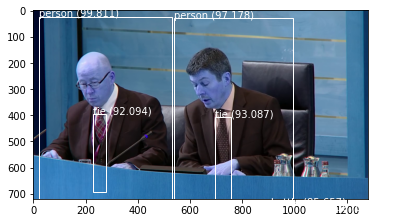

   Working on 260_3.mp4 frame 30 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.81210231781006
person 99.5526373386383
tie 91.00935459136963
tie 98.6015260219574
bottle 76.83437466621399
bottle 60.86376905441284


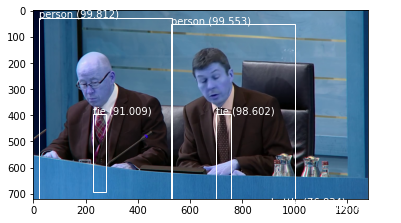

   Working on 260_3.mp4 frame 40 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.81955885887146
person 99.30765628814697
tie 91.92288517951965
tie 99.07283186912537
bottle 69.3888247013092
bottle 76.04520916938782
bottle 71.15916013717651


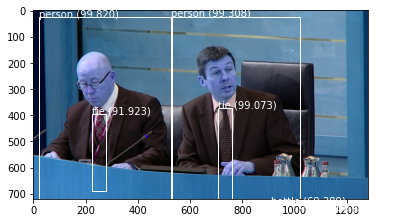

   Working on 260_3.mp4 frame 50 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.70865845680237
person 99.22789335250854
tie 89.9355411529541
tie 99.54851865768433
bottle 82.43106007575989
bottle 78.66313457489014
bottle 76.60694718360901


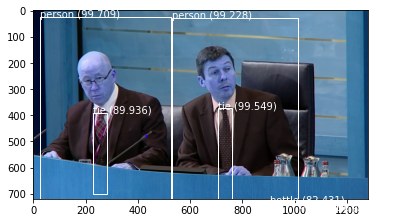

   Working on 260_3.mp4 frame 60 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.77371096611023
person 99.44282174110413
tie 90.59547781944275
tie 99.32242035865784
bottle 85.24600863456726
bottle 76.40286087989807
bottle 75.2946674823761


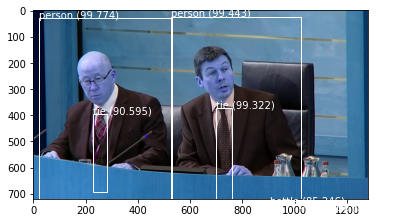

   Working on 260_3.mp4 frame 70 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.79972243309021
person 99.49782490730286
tie 90.13447165489197
tie 99.63705539703369
bottle 83.1200659275055
bottle 75.21175742149353
bottle 80.029296875


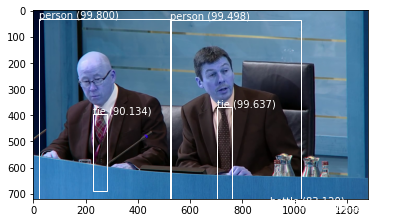

   Working on 260_3.mp4 frame 80 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.79570508003235
person 99.43597912788391
tie 89.24444913864136
tie 99.45275783538818
bottle 78.49676012992859
bottle 71.87922596931458
bottle 77.11339592933655


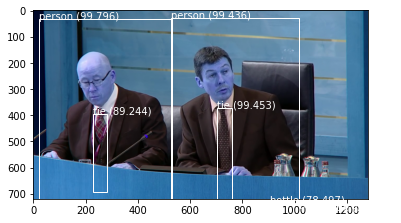

   Working on 260_3.mp4 frame 90 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.77735877037048
person 99.44592714309692
tie 89.1788125038147
tie 99.59991574287415
bottle 78.52754592895508
bottle 72.67509698867798
bottle 77.14110016822815


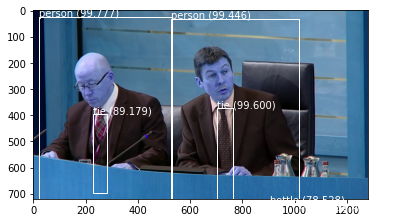

   Working on 260_3.mp4 frame 100 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.73286986351013
person 99.56802725791931
tie 89.14476037025452
tie 99.67498779296875
bottle 81.07007145881653
bottle 71.61473631858826
bottle 79.42646145820618


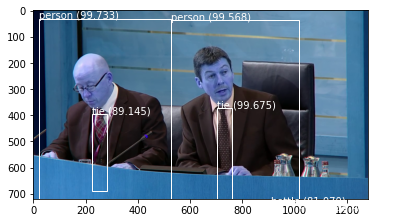

   Working on 260_3.mp4 frame 110 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.69625473022461
person 99.54307675361633
tie 89.78368639945984
tie 99.04348850250244
bottle 77.97302007675171
bottle 61.09241843223572
bottle 67.42237210273743


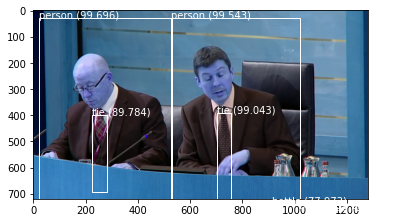

   Working on 260_3.mp4 frame 120 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.71064925193787
person 98.1242835521698
tie 91.68646931648254
tie 87.63673901557922
bottle 81.96065425872803
bottle 64.33578133583069
bottle 69.10247802734375


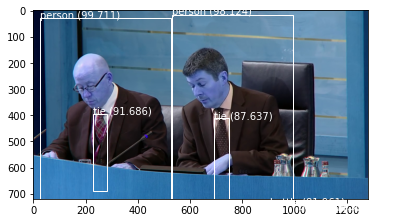

Processing video 0/10 with name 245_1.mp4

   Working on 245_1.mp4 frame 0 video num 0
Showing sample frame for 245_1.mp4 with shape (720, 1280, 3)
printing type image
<class 'numpy.ndarray'>
Original frame: 


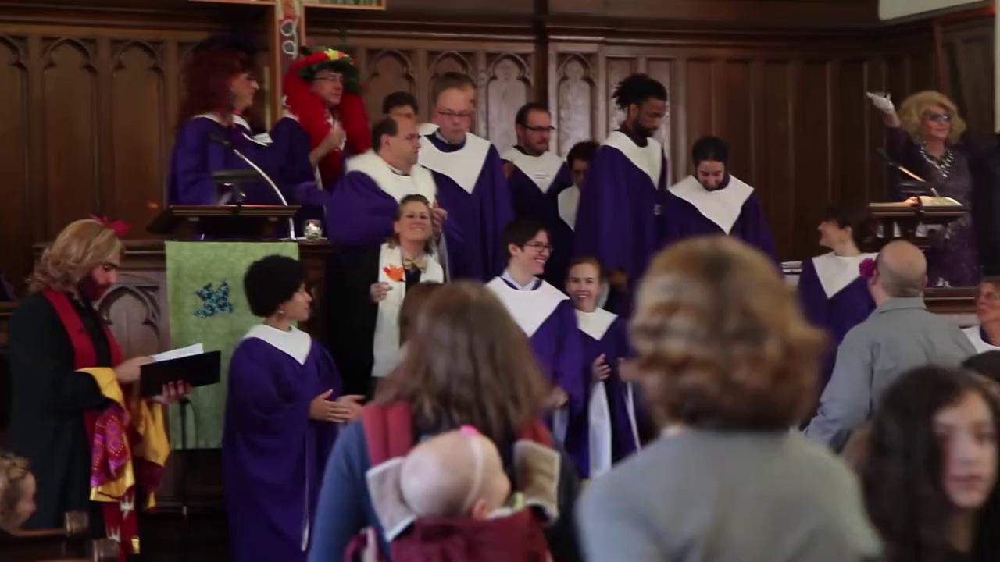


Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.0483045578003
person 99.82559084892273
person 91.27987027168274
person 80.77986240386963
person 81.73537850379944
person 66.87410473823547
person 97.73080348968506
person 95.40919661521912
person 99.33090209960938
person 82.9567551612854


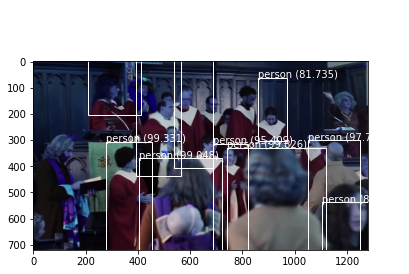

   Working on 245_1.mp4 frame 10 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 83.8161051273346
person 99.81921315193176
person 95.44989466667175
person 86.34189963340759
person 76.27145051956177
person 65.03776907920837
person 95.77829837799072
person 96.4151382446289
person 94.25093531608582
person 92.77803897857666
person 70.24368047714233
person 98.84561896324158
person 90.78951478004456
person 87.46660351753235


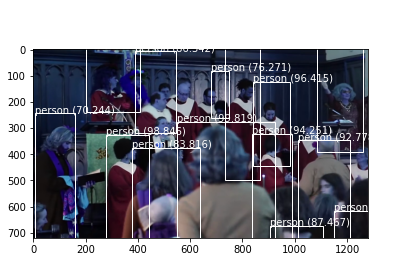

   Working on 245_1.mp4 frame 20 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 91.82320833206177
person 98.76350164413452
person 96.58438563346863
person 95.39822340011597
person 93.80802512168884
person 78.68945002555847
person 85.9013319015503
person 64.59536552429199
person 79.50966954231262
person 90.51594138145447


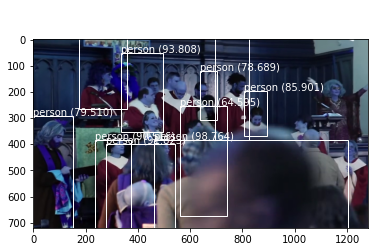

   Working on 245_1.mp4 frame 30 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.87623691558838
person 97.1598744392395
person 64.88958597183228
person 80.89506030082703
person 89.82442021369934
person 61.2579345703125
person 87.56745457649231
person 94.06496286392212
person 64.86634612083435
person 66.82286858558655
person 85.26772856712341
person 98.53776097297668
person 87.82337307929993


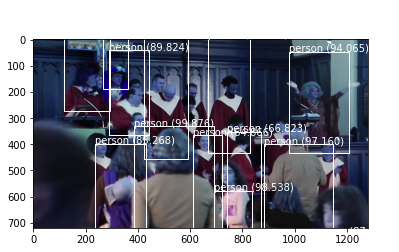

   Working on 245_1.mp4 frame 40 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 97.88235425949097
person 62.04150319099426
person 68.31889748573303
person 82.20632076263428
person 98.5439121723175
person 68.47593188285828
person 61.416566371917725
person 83.901846408844
person 64.27317261695862


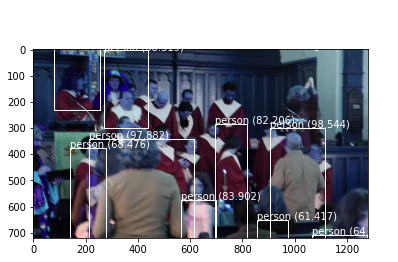

   Working on 245_1.mp4 frame 50 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 98.53523373603821
person 98.361074924469
person 95.1836884021759
person 63.755446672439575
person 89.32143449783325
person 69.58386301994324
person 73.60345125198364
person 90.0066614151001
person 70.58508396148682
person 72.43655920028687
person 98.77309203147888
person 99.79672431945801
person 99.59694147109985
person 91.71078205108643
person 64.81430530548096
person 68.51977109909058
person 87.28995323181152


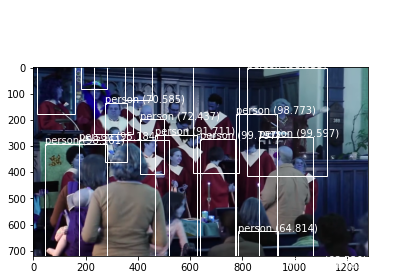

   Working on 245_1.mp4 frame 60 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 98.76947402954102
person 87.23846077919006
person 92.41083264350891
person 90.6816303730011
person 82.8818142414093
person 68.6391294002533
person 94.81195211410522
person 99.65667724609375
person 95.89952230453491
person 85.55907607078552


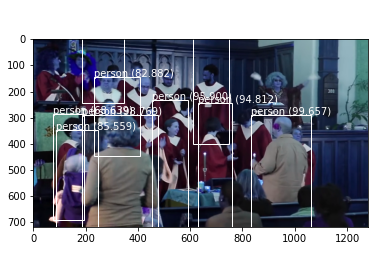

   Working on 245_1.mp4 frame 70 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.29273128509521
person 61.42980456352234
person 91.93893074989319
person 60.89435815811157
person 69.48618292808533
person 95.7555890083313
person 71.65248394012451
person 98.48946332931519
person 85.65585613250732
person 99.68551993370056
person 86.7066502571106
person 81.72293901443481
person 88.68317604064941


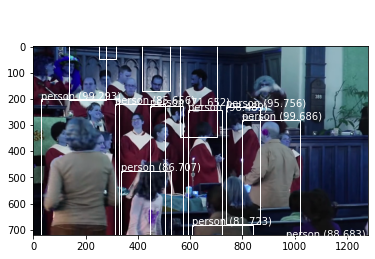

   Working on 245_1.mp4 frame 80 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.80115294456482
person 72.14714288711548
person 74.9584972858429
person 91.28351211547852
person 60.658639669418335
person 99.02081489562988
person 96.20876908302307
person 69.09084916114807
person 67.01061725616455


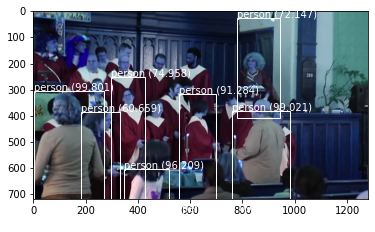

   Working on 245_1.mp4 frame 90 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.58362579345703
person 68.17012429237366
person 70.87219953536987
person 87.00328469276428
person 91.11319184303284
person 98.90195727348328
person 93.4997022151947
person 87.60026693344116
person 98.0273187160492
person 84.82730388641357


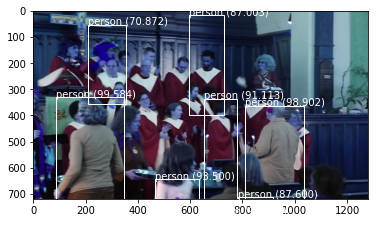

   Working on 245_1.mp4 frame 100 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.13201928138733
person 76.03728771209717
person 74.11510348320007
person 89.52040672302246
person 61.21603846549988
person 77.58169174194336
person 86.25693321228027
person 95.71041464805603
person 99.38979744911194
person 98.61634969711304
person 96.62413597106934
person 95.52295207977295
person 82.55386352539062


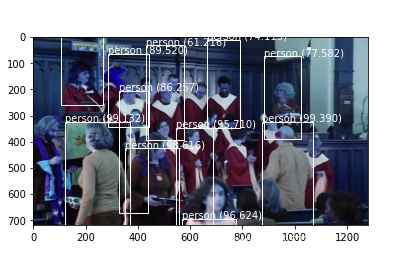

   Working on 245_1.mp4 frame 110 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.27070140838623
person 86.26915216445923
person 68.26553344726562
person 62.409794330596924
person 72.33251929283142
person 69.90662813186646
person 79.8760712146759
person 76.85154676437378
person 96.14915251731873
person 83.71499180793762
person 99.27257299423218
person 96.63188457489014
person 80.25355339050293
person 98.95001649856567
person 85.47217845916748


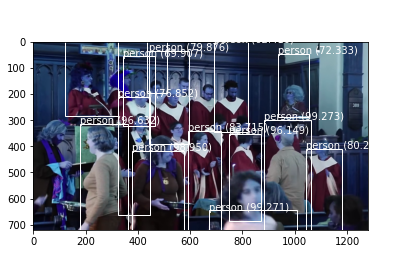

Processing video 0/10 with name 210_20.mp4

   Working on 210_20.mp4 frame 0 video num 0
Showing sample frame for 210_20.mp4 with shape (720, 1280, 3)
printing type image
<class 'numpy.ndarray'>
Original frame: 


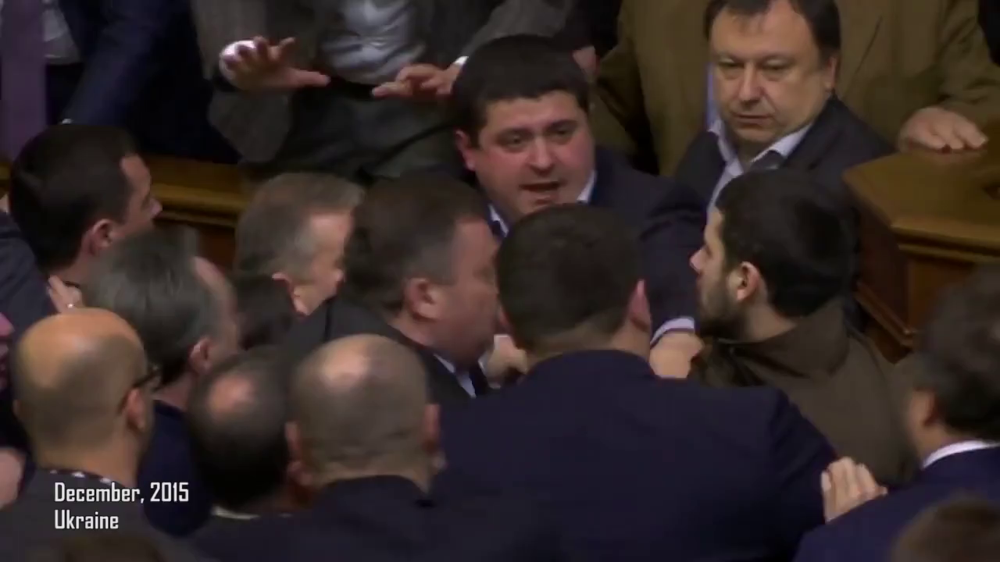


Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 74.39261674880981
person 87.9364013671875
person 66.47274494171143
person 84.36434268951416
person 77.5915265083313


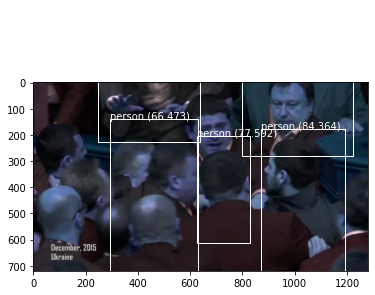

   Working on 210_20.mp4 frame 10 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 88.42046856880188
person 87.10165619850159
person 60.23470759391785
person 89.86008763313293
person 83.29885601997375
person 91.68583154678345


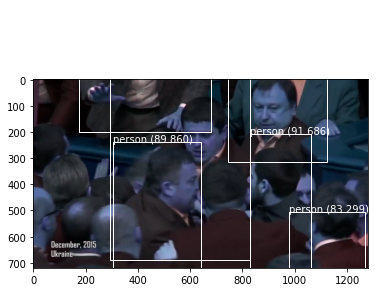

   Working on 210_20.mp4 frame 20 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 84.49353575706482
person 86.01239323616028
person 89.53313827514648
person 62.31998801231384
person 96.5303122997284
person 89.49017524719238


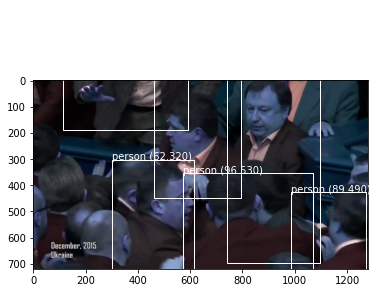

   Working on 210_20.mp4 frame 30 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 85.80085039138794
person 84.36128497123718
person 92.2294020652771
person 62.358659505844116


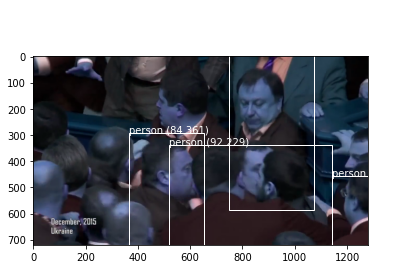

   Working on 210_20.mp4 frame 40 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 85.56843400001526
person 97.26132154464722


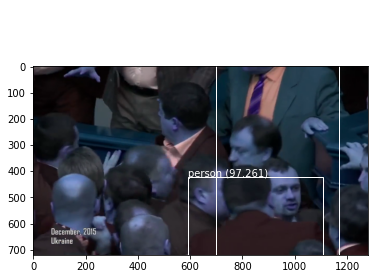

   Working on 210_20.mp4 frame 50 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 69.40955519676208
person 92.0998215675354
person 66.58435463905334
tie 63.92645239830017
person 65.5976414680481
person 65.33687114715576


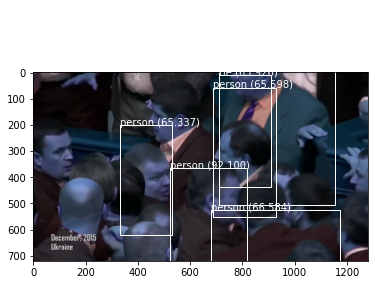

   Working on 210_20.mp4 frame 60 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 90.72691202163696
person 66.0755455493927
person 72.41014838218689
person 80.80109357833862
person 80.80542087554932


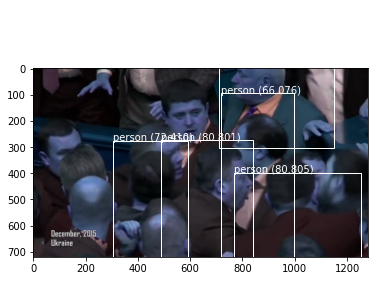

   Working on 210_20.mp4 frame 70 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 67.04096794128418
tie 71.9458281993866


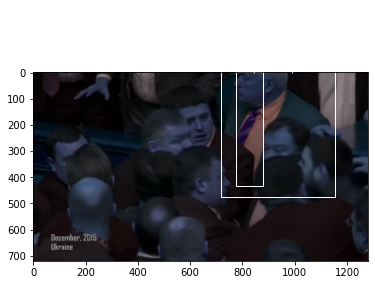

   Working on 210_20.mp4 frame 80 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]


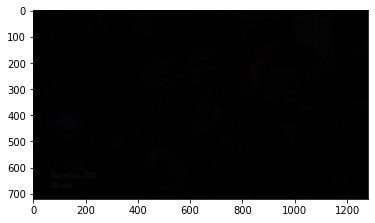

   Working on 210_20.mp4 frame 90 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]


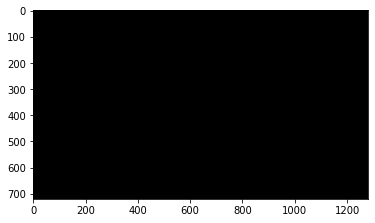

   Working on 210_20.mp4 frame 100 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]


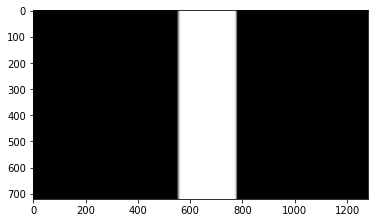

   Working on 210_20.mp4 frame 110 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]


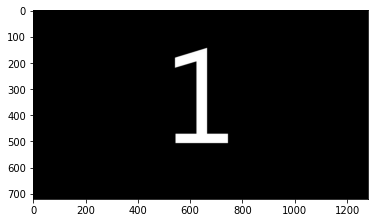

   Working on 210_20.mp4 frame 120 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]


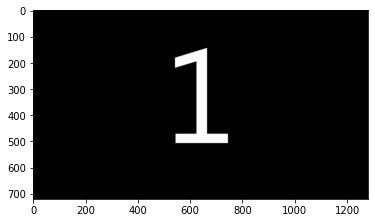

Processing video 0/10 with name 245_3.mp4

   Working on 245_3.mp4 frame 0 video num 0
Showing sample frame for 245_3.mp4 with shape (720, 1280, 3)
printing type image
<class 'numpy.ndarray'>
Original frame: 


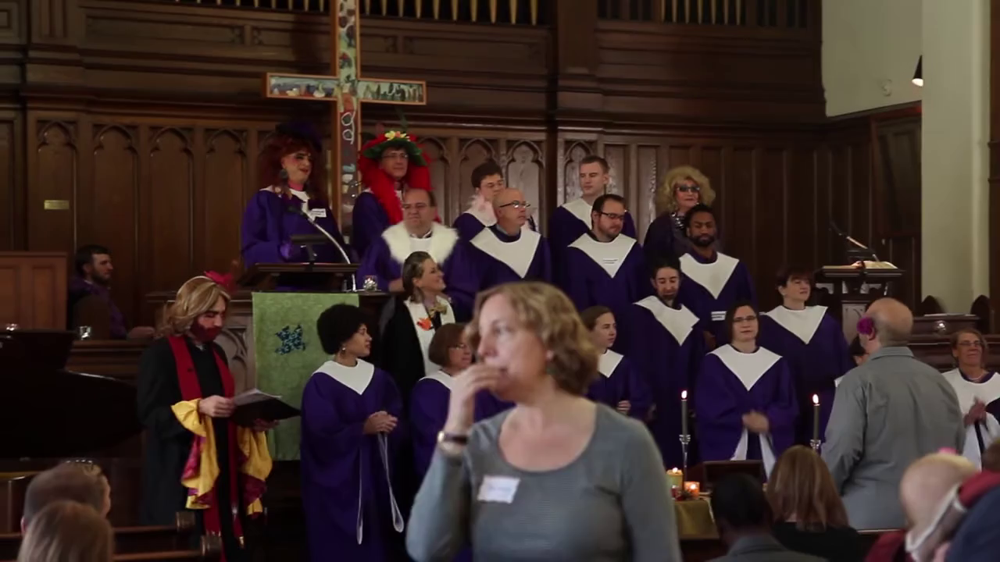


Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.2432177066803
person 96.63524627685547
person 73.47465753555298
person 66.00982546806335
person 81.63079023361206
person 63.50858211517334
person 91.37786626815796
person 89.5992636680603
person 93.61404180526733
person 97.84508943557739
person 98.34796190261841
person 80.92923164367676
person 76.15196108818054


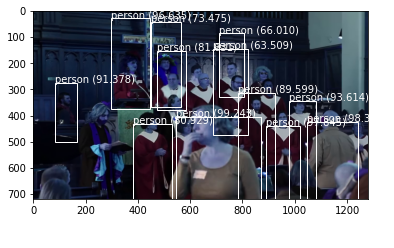

   Working on 245_3.mp4 frame 10 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 98.5575020313263
person 94.57983374595642
person 82.98705816268921
person 90.25099277496338
person 63.68284225463867
person 62.31555938720703
person 79.1536033153534
person 97.02549576759338
person 67.21712350845337
person 99.34332370758057
person 60.12042164802551


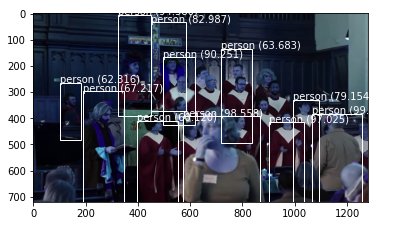

   Working on 245_3.mp4 frame 20 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 98.34357500076294
person 91.1375343799591
person 75.40130615234375
person 88.75865340232849
person 60.71774959564209
person 66.32823348045349
person 77.4852454662323
person 98.92632365226746
person 73.02359342575073
person 93.65102648735046
person 69.04149055480957


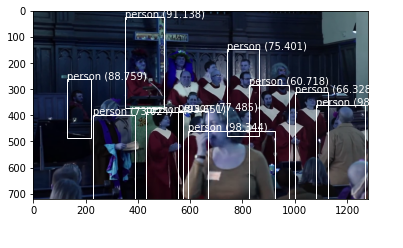

   Working on 245_3.mp4 frame 30 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.70909357070923
person 96.30285501480103
person 79.33850884437561
person 88.64271640777588
person 85.17890572547913
person 83.12996625900269
person 78.79242300987244
person 93.32388639450073
person 80.16667366027832
person 90.48213362693787
person 99.49548244476318
person 93.73274445533752
person 62.92956471443176


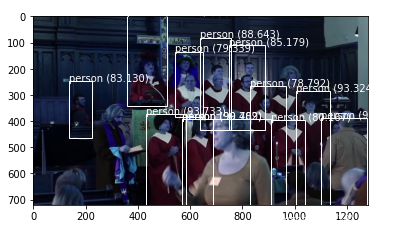

   Working on 245_3.mp4 frame 40 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.88188147544861
person 93.45826506614685
person 94.69484090805054
person 73.42718839645386
person 71.73668146133423
person 99.8083233833313
person 92.80205368995667
person 94.94946002960205
person 63.473886251449585
person 68.4715211391449


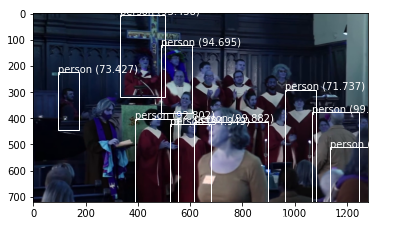

   Working on 245_3.mp4 frame 50 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.88421201705933
person 92.74970293045044
person 83.86773467063904
person 91.8103277683258
person 83.49847197532654
person 62.37350106239319
person 78.56631278991699
person 66.7394757270813
person 69.43206787109375
person 93.40702891349792
person 98.28553199768066
person 70.20105123519897
person 91.10243320465088


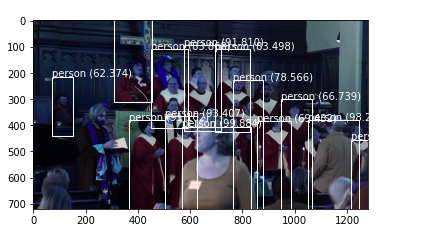

   Working on 245_3.mp4 frame 60 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.67548251152039
person 72.50552177429199
person 93.12983751296997
person 93.81400346755981
person 87.30968832969666
person 79.33841943740845
person 71.23600244522095
person 84.91489887237549
person 64.64276313781738
person 90.28863906860352
person 74.33844804763794
person 92.9477870464325
person 97.5875735282898
person 98.9916443824768
person 90.29088020324707


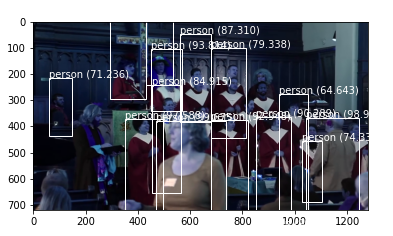

   Working on 245_3.mp4 frame 70 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.53740239143372
person 83.6485743522644
person 61.90804839134216
person 64.77068662643433
person 72.87279963493347
person 69.74331140518188
person 93.74021887779236
person 98.73473048210144
person 79.56597208976746
person 77.82870531082153


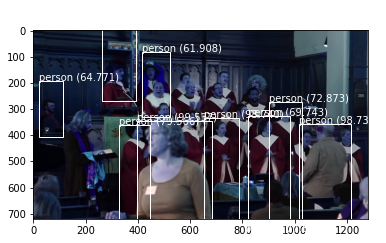

   Working on 245_3.mp4 frame 80 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.64255094528198
person 87.95570731163025
person 67.21962094306946
person 88.23367953300476
person 63.82051706314087
person 84.40513014793396
person 97.91234731674194
person 81.18515610694885
person 99.42772388458252
person 77.78045535087585
person 98.49125146865845
person 84.68442559242249


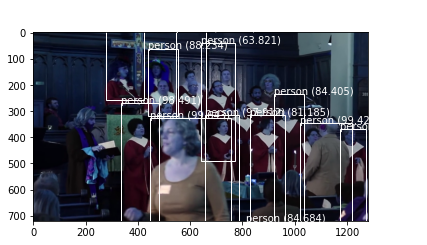

   Working on 245_3.mp4 frame 90 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 98.4423041343689
person 89.09332752227783
person 62.24501132965088
person 83.27102065086365
person 80.23440837860107
person 84.25109386444092
person 84.14332866668701
person 84.71037745475769
person 92.91988611221313
person 99.51500296592712
person 78.61160039901733
person 93.54264736175537
person 64.55837488174438


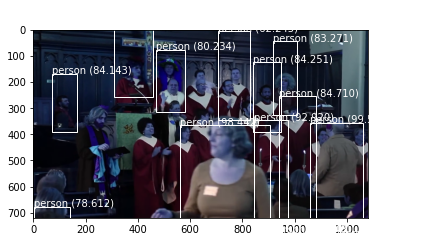

   Working on 245_3.mp4 frame 100 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 98.13972115516663
person 92.015141248703
person 80.78801035881042
person 72.92028069496155
person 61.394643783569336
person 86.84303760528564
person 81.77456259727478
person 72.67675399780273
person 91.47363305091858
person 65.22766947746277
person 65.04416465759277
person 97.8447437286377
person 77.35500931739807


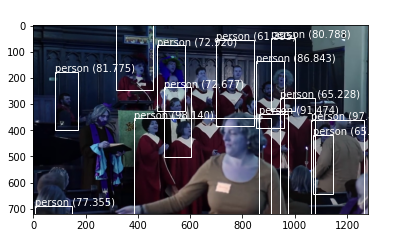

   Working on 245_3.mp4 frame 110 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 97.51405715942383
person 93.3346688747406
person 78.90898585319519
person 61.89295053482056
person 92.72373914718628
person 99.34987425804138
person 91.7895495891571
person 90.88800549507141
person 91.76598787307739


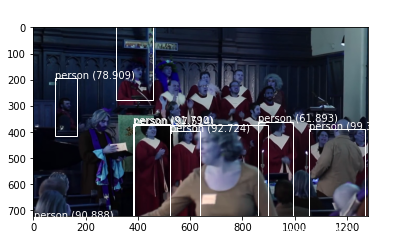

Processing video 0/10 with name 245_10.mp4

   Working on 245_10.mp4 frame 0 video num 0
Showing sample frame for 245_10.mp4 with shape (720, 1280, 3)
printing type image
<class 'numpy.ndarray'>
Original frame: 


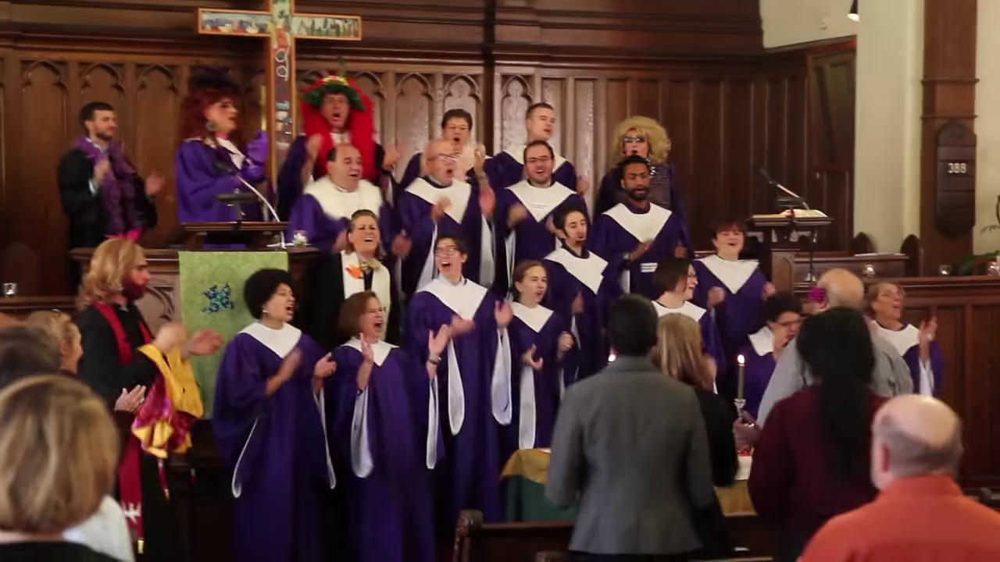


Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.63498711585999
person 96.36127352714539
person 70.48031687736511
person 67.19869375228882
person 73.40575456619263
person 65.30084013938904
person 92.25941300392151
person 81.15355968475342
person 98.32271337509155
person 91.46780371665955


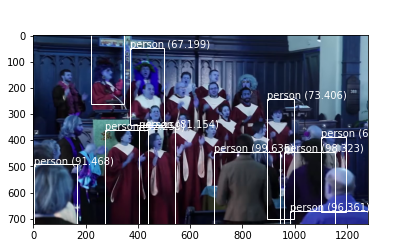

   Working on 245_10.mp4 frame 10 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 97.34097719192505
person 77.91551351547241
person 82.0004940032959
person 88.80636692047119
person 70.65006494522095
person 91.63356423377991
person 72.16216921806335
person 95.14566659927368
person 82.98923373222351
person 95.27196884155273
person 75.82248449325562
person 99.44098591804504


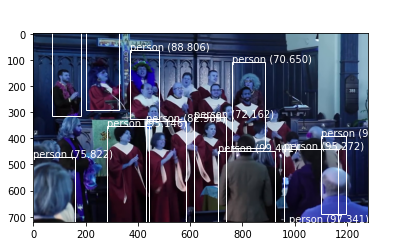

   Working on 245_10.mp4 frame 20 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 93.7874436378479
person 94.9117660522461
person 75.89364051818848
person 69.85681056976318
person 67.17172265052795
person 62.83333897590637
person 63.02297115325928
person 93.67998838424683
person 97.44164943695068
person 99.23734664916992
person 94.82754468917847
person 96.56902551651001
person 97.81971573829651


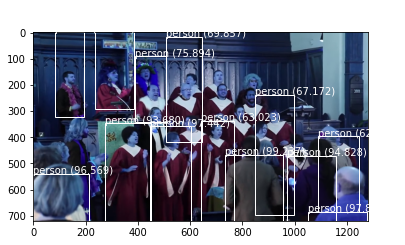

   Working on 245_10.mp4 frame 30 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 90.33126831054688
person 79.23152446746826
person 67.43946075439453
person 60.30263900756836
person 66.10694527626038
person 65.80024361610413
person 60.89791655540466
person 90.46172499656677
person 87.30968236923218
person 99.62183237075806
person 98.72186779975891
person 97.64348268508911
person 92.01886653900146


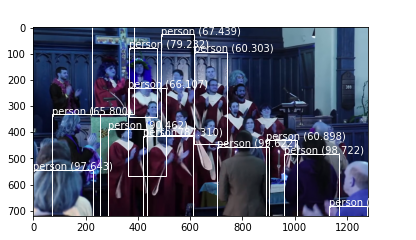

   Working on 245_10.mp4 frame 40 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 70.62533497810364
person 80.57571053504944
person 60.31944751739502
person 82.87165760993958
person 97.34581112861633
person 87.04164624214172
person 82.48763680458069
person 88.25290203094482
person 99.69688653945923
person 99.79190826416016
person 95.85127830505371
person 90.28963446617126


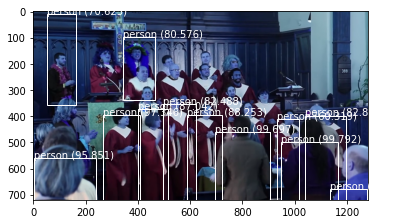

   Working on 245_10.mp4 frame 50 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.71961975097656
person 85.6725811958313
person 73.30060005187988
person 90.67485928535461
person 63.77960443496704
person 78.9853036403656
person 89.0079140663147
person 69.6979284286499
person 76.57055854797363
person 98.58309626579285
person 92.50462651252747
person 95.80064415931702


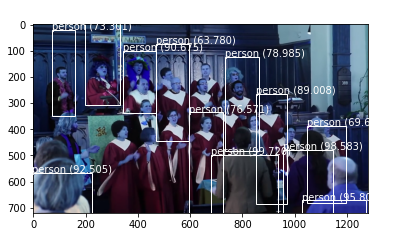

   Working on 245_10.mp4 frame 60 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 88.88851404190063
person 80.76558113098145
person 83.91709327697754
person 77.26491093635559
person 65.0233507156372
person 82.98348188400269
person 66.80307388305664
person 77.87900567054749
person 66.51679277420044
person 88.12218904495239
person 79.34340834617615
person 99.01758432388306
person 98.47943782806396
person 94.64491009712219


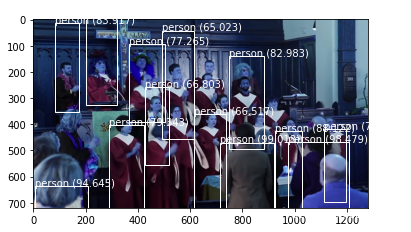

   Working on 245_10.mp4 frame 70 video num 0
printing type image
<class 'numpy.ndarray'>
Shape of image is (416, 416, 3)
Summarize the shape of the list of arrays
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.00313019752502
person 71.42601013183594
person 93.19325685501099
person 91.47315621376038
person 77.49607563018799
person 65.64868092536926
person 71.53118848800659
person 74.1221010684967
person 61.510664224624634
person 95.66558599472046
person 69.72095370292664
person 76.49440169334412
person 88.39573860168457
person 89.26921486854553
person 97.91579246520996
person 96.61054015159607
Buffered data was truncated after reaching the output size limit.

In [0]:
# Running over all videos now

# Getting a list of all video files in a directory
file_path_names = glob.glob(os.path.join(TRAIN_PATH, '*.mp4'))
filenames = [os.path.basename(file_path_name) for file_path_name in file_path_names]

# # Just testing a few, can comment out later
# filenames = ['344_7.mp4', '260_13.mp4', '220_4.mp4', '245_8.mp4']

print(filenames)

# Process all videos, run YOLO, and store output
metadata_all = {}
for video_filename in filenames:
    print('Processing video: {}'.format(video_filename))
    metadata = process_video(video_dir=TRAIN_PATH, video_name=video_filename, video_num=0, total_videos=10, model=model)
    metadata_all.update(metadata)

In [0]:
with open(os.path.join(TRAIN_PATH, 'yolov3', 'metadata_all.json'), 'w') as fp:
    json.dump(metadata_all, fp, sort_keys=True, indent=4, separators=(',', ': '))